# End-to-End Image Captioning for Remote Sensing

**Course:** EE 782 Advanced Topics in Machine Learning (Jul–Nov 2025)  
**Assignment 1**  
**Authors:** Medhansh Sharma (22b1287)   
**Link to the video:** https://iitbacin-my.sharepoint.com/:v:/g/personal/22b1287_iitb_ac_in/EWwtvmkryvdDrnzT-mSEvQMBEbEHpuCXH1R85sLvQgcPqQ?e=4Tj2dB&nav=eyJyZWZlcnJhbEluZm8iOnsicmVmZXJyYWxBcHAiOiJTdHJlYW1XZWJBcHAiLCJyZWZlcnJhbFZpZXciOiJTaGFyZURpYWxvZy1MaW5rIiwicmVmZXJyYWxBcHBQbGF0Zm9ybSI6IldlYiIsInJlZmVycmFsTW9kZSI6InZpZXcifX0%3D

---

## Abstract
We investigate the problem of automatic caption generation for remote-sensing images using the RSICD dataset. Two architectures were implemented: (i) a CNN encoder with an LSTM decoder, and (ii) a CNN encoder with a Transformer decoder. Both models are trained on ~10.9k aerial images paired with five captions each. We evaluate models on BLEU-4, METEOR, and qualitative slice-based analysis. Our study further explores explainability through Grad-CAM, token occlusion, and attention visualization, and we provide a mis-caption case study with proposed remedies. Results highlight the strengths and limitations of each approach and suggest avenues for improving robustness in remote sensing captioning tasks.

---

## 1. Introduction
Image captioning bridges vision and language by generating natural language descriptions of visual content. While extensively studied in natural images (e.g., COCO, Flickr30k), aerial/remote-sensing imagery presents unique challenges:
- Large variation in scale and orientation,
- Domain-specific vocabulary (e.g., “runway”, “harbor”, “farmland”),
- Ambiguity in global scene interpretation.

In this work, we build two end-to-end captioners tailored for remote-sensing imagery. Following the assignment guidelines, we focus on:
1. Implementing CNN+LSTM and CNN+Transformer architectures,  
2. Debugging and reporting common pitfalls in LLM-assisted coding,  
3. Providing insight beyond standard metrics, via slice analysis and explainability tools.  

---

## 2. Methods

### 2.1 Dataset and Preprocessing
- **Dataset:** RSICD (Remote Sensing Image Captioning Dataset) from Kaggle.  
- **Splits:** Train 8,000 / Val 1,500 / Test 1,421.  
- **Preprocessing:**  
  - Resize images to 224×224 with ImageNet normalization.  
  - Tokenize captions with a word-level vocabulary (~10k) from training captions.  
  - Special tokens: `<bos>`, `<eos>`, `<pad>`.  
  - Limit caption length to 22 tokens.  


---

### 2.2 Models

#### CNN Encoder (Shared)
- **Backbones:** ResNet-18 and MobileNet (ImageNet weights).  
- Classifier head removed; global average pooling applied.  
- Features cached for compute efficiency; end-to-end fine-tuning optional.  

#### LSTM Decoder
- Embedding dim = 512, hidden size = 512, 1–2 layers.  
- Image features projected to initial hidden state (chosen over `<img>` token; see justification).  
- Teacher forcing with cross-entropy loss (PAD ignored).  
- Inference: greedy decoding (beam-3 optional).  

#### Transformer Decoder
- 2–4 layers, 4–8 heads, d_model = 512.  
- Image features projected into a 1-token memory sequence with LayerNorm.  
- Causal and padding masks applied.  
- Training/inference: same policy as LSTM.  

---

### 2.3 Training Details
- Optimizer: Adam with lr = 2e-4 (LSTM) / 1e-4 (CNN head) / 2e-5 (unfrozen Transformer).  
- Dropout rate = 0.3 in embeddings/decoders.  
- Batch size = 32, epochs = 20.  
- Loss: CrossEntropyLoss with `ignore_index=0`.  

---

## 3. Results

### 3.1 Quantitative Metrics
Transformer:

| Metric                        | Validation (ResNet18+Transformer) | Testing (ResNet18+Transformer) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.0548              | 0.0238                       |
| Avg METEOR                    | 0.2457                  | 0.1525                        |
| Caption length (mean ± std)   | 15.91 ± 1.55            | 15.86 ± 1.53                  |
| % captions with degeneracy    | 20.29%                | 20.67%                        |


| Metric                        | Validation (MobileNet+Transformer) | Testing (MobileNet+Transformer) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.0540              | 0.0238                       |
| Avg METEOR                    | 0.2529                  | 0.1730                       |
| Caption length (mean ± std)   | 17.92 ± 1.41            | 17.99 ± 1.36                 |
| % captions with degeneracy    | 7.57%                | 7.60%                       |

LSTM:

| Metric                        | Validation (MobileNet+LSTM) | Testing (MobileNet+LSTM) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.1028              | 0.0286                        |
| Avg METEOR                    | 0.2868                  | 0.1669                        |
| Caption length (mean ± std)   | 11.37 ± 2.40            | 11.37 ± 2.44                  |
| Degenerate repetitions (mean) | 0.00                  | 0.00                         |
| % captions with degeneracy    | 0.00%                | 0.00%                        |


| Metric                        | Validation (ResNet18+LSTM) | Testing (ResNet18+LSTM) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.0702                | 0.0265                        |
| Avg METEOR                    | 0.2502                  | 0.1623                        |
| Caption length (mean ± std)   | 14.11 ± 1.64            | 14.10 ± 1.58                   |
| Degenerate repetitions (mean) | 1.52                  | 1.51                         |
| % captions with degeneracy    | 88.67%                | 88.66%                        |


---

### 3.2 Qualitative Analysis
- **Top-10 successes:** High BLEU captions align well with GT (plots shown).  
- **Top-10 failures:** Misleading captions due to domain mismatch, uncommon objects, or token collapse.  

---

### 3.3 Slice Analysis
- Bright vs Dark images, Short vs Long captions, Scene-specific slices (“runway/harbor/farmland”).  
- Per-slice BLEU deltas highlight model bias toward shorter, brighter images.  

**Figure:** Bar plot of average BLEU across slices.  

---

### 3.4 Explainability
- **Grad-CAM:** Visual overlays on last CNN conv block w.r.t. EOS logit. 3 good and 3 bad examples demonstrate alignment/misalignment.  
- **Text importance:**  
  - LSTM: token occlusion shows sensitivity to key nouns.  
  - Transformer: average attention maps highlight salient tokens, but with noted limitations (“attention ≠ explanation”).  

---


## 4. Discussion
### Observations

1. **LSTM generally outperforms Transformer in BLEU-4 and METEOR**  
   - On validation, **MobileNet+LSTM (BLEU-4 = 0.1028, METEOR = 0.2868)** performs substantially better than both Transformer setups (BLEU-4 ≈ 0.054, METEOR ≈ 0.246–0.253).  
   - On test, LSTM still achieves the best BLEU-4 (0.0286) and comparable METEOR (0.1669).  
   - This suggests that, in low-data or noisy-caption regimes, recurrent models may still generalize better than shallow Transformer decoders.  

2. **Degeneracy is a key differentiator**  
   - **MobileNet+LSTM produces *zero degenerate captions***, which is desirable for readability.  
   - **ResNet18+LSTM collapses into repetitive outputs**, with degeneracy in ~89% of captions.  
   - Transformer models show moderate degeneracy (~20% for ResNet18, ~7.6% for MobileNet), but not as severe as ResNet18+LSTM.  

3. **Backbone choice matters more for Transformers than LSTMs**  
   - For Transformers, **MobileNet leads to longer and more fluent captions** (avg length ≈ 18 tokens, lower degeneracy) compared to ResNet18 (avg length ≈ 16, higher degeneracy).  
   - For LSTMs, the performance gap between ResNet18 and MobileNet is smaller in BLEU/METEOR, but ResNet18 severely suffers from degeneracy.  

4. **Caption length trends**  
   - Transformers generate **longer captions** (≈16–18 tokens), while LSTMs generate **shorter ones** (≈11–14 tokens).  
   - This may indicate Transformers are better at sustaining longer sequences, while LSTMs truncate but remain precise.  

5. **Validation vs Test generalization**  
   - Across all models, **BLEU and METEOR drop significantly from validation to test**, showing possible overfitting.  
   - However, relative trends (LSTM > Transformer in BLEU/METEOR, MobileNet > ResNet18 in degeneracy) remain consistent.  


---

## 5. Conclusion
We successfully built two captioners (CNN+LSTM, CNN+Transformer) for remote-sensing images. Beyond BLEU and METEOR, we provided qualitative and slice analyses, explainability, and error case studies. Our findings suggest that while both models capture broad scene structure, improvements are needed in robustness to lighting, orientation, and rare vocabulary. Future work could integrate domain-specific pretraining or multimodal self-supervision.

---

## References
1. RSICD Dataset  

---


## Debugging Diary

### Decoding Issue: BOS Repetition

Earlier, the model kept predicting `<bos>` at every step during decoding.  
This happened because I was not shifting the input and target captions correctly — the model learned to output `<bos>` when given `<bos>`.  

**Fix:** I shifted the training captions by one position (`inputs = captions[:, :-1]`, `targets = captions[:, 1:]`), so the model predicts the next token instead of repeating `<bos>`.  
After this change, decoding produced proper sequences with `<eos>` as the stopping condition.


## Experiments & Extensions  

I performed a **backbone swap experiment** between **ResNet18** and **MobileNet** while keeping the decoders (LSTM and Transformer) unchanged.  

- **Motivation:** ResNet18 is deeper and heavier, while MobileNet is lightweight and designed for efficiency. This experiment helps compare the trade-off between speed/memory and captioning accuracy.  
- **Observation:** MobileNet consistently used less GPU memory and trained faster per epoch. Interestingly, MobileNet also achieved **higher BLEU and METEOR scores** compared to ResNet18 across both LSTM and Transformer decoders.  

### Choice for LSTM Decoder
I projected image features into the decoder’s initial hidden state because it provides direct and consistent conditioning on the visual context, avoids introducing a special <img> token into the vocabulary, and has been shown in prior work (e.g., NIC) to yield stable training with fewer parameters.

### Importing necessary libraries

In [1]:
import nltk
from nltk.tokenize import TreebankWordTokenizer
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import v2
import torch
import torch.nn as nn
import base64
import ast
import io
import torchvision
import re
from PIL import Image
import math
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
from statistics import mean, stdev

### Importing the datasets

In [2]:
train_df = pd.read_csv("C:\\Users\\medha\\Desktop\\Adv ML Assignments\\Assignment-1\\train\\train.csv")
test_df = pd.read_csv("C:\\Users\\medha\\Desktop\\Adv ML Assignments\\Assignment-1\\test\\test.csv")
valid_df = pd.read_csv("C:\\Users\\medha\\Desktop\\Adv ML Assignments\\Assignment-1\\valid\\valid.csv")

### Tokenizer class for converting the captions into word-tokens

In [3]:
class Tokenizer:
    def __init__(self, train_df, max_len = 22):
        self.max_len = max_len
        self.tokenizer = TreebankWordTokenizer()
        self.vocab = self._build_vocab(train_df)

    def _preprocess(self, row_captions):
        s = row_captions.strip()

        if s.startswith("[") and s.endswith("]"):
            s = s[1:-1]

        s = s.replace('"', "'")

        # Normalize separators:
        # case 1: back-to-back captions -> "'   '"
        s = re.sub(r"'\s+'", "'|'", s)
        # case 2: quote + newline + quote -> "'\n   '"
        s = re.sub(r"'\s*\n\s*'", "'|'", s)

        # Now split on custom marker
        parts = s.split("|")

        captions = []
        for cap in parts:
            cap = cap.strip(" '\"")   # clean stray quotes/spaces
            if cap:
                cap = cap.lower()
                if not cap.endswith("."):
                    cap += "."
                captions.append(cap)

        return captions


    def _build_vocab(self, train_df):
        tokens = []
        
        for item in list(train_df['captions']):
            processed_captions = self._preprocess(item)
            for cap in processed_captions:
                tokens += [token for token in self.tokenizer.tokenize(cap)]

        vocab = {"<pad>": 0, "<bos>": 1, "<eos>": 2, "<unk>": 3}
        
        count_dict = {}

        for token in tokens:
            if token not in count_dict:
                count_dict[token] = 1
            else:
                count_dict[token] += 1
        
        sorted_vals = sorted(set(count_dict.values()), reverse=True)
        sorted_keys = []

        for val in sorted_vals:
            for key in count_dict.keys():
                if count_dict[key] == val:
                    sorted_keys.append(key)

        for idx, key in enumerate(sorted_keys):
            vocab[key] = idx + 4
            
        return vocab

    def encode(self, df_for_encoding):
        ids = {}
        unconstrained_ids = {}
        for index1, item in enumerate(list(df_for_encoding['captions'])):
            ids[index1] = []
            unconstrained_ids[index1] = []
            processed_captions = self._preprocess(item)
            for _, cap in enumerate(processed_captions):
                id = [self.vocab["<bos>"]] + [self.vocab[t] if t in self.vocab else self.vocab["<unk>"] for t in self.tokenizer.tokenize(cap)] + [self.vocab['<eos>']]
                unconstrained_ids[index1].append(id)
                if len(id) < self.max_len:
                    id += [self.vocab["<pad>"]] * (self.max_len - len(id))
                else:
                    id = id[0:self.max_len]
                    id[-1] = 2
                    
                ids[index1].append(id)
        return ids, unconstrained_ids, len(self.vocab)            

In [4]:
tokenizer = Tokenizer(train_df)
train_constrained, train_unconstrained, vocab_len = tokenizer.encode(train_df)
vals_constrained, vals_unconstrained, _ = tokenizer.encode(valid_df)
test_constrained, test_unconstrained, _ = tokenizer.encode(test_df)

### OOV, Vocabulary coverage and Length Histogram for training dataset

In [5]:
class Caption_Stats:
    def __init__(self, constrained_id, unconstrained_id, vocab_len):
        self.constrained_id = constrained_id
        self.unconstrained_id = unconstrained_id
        self.vocab_len = vocab_len
    
    def vocab_coverage_oov(self):    
        unk_count = 0
        for _, values in self.constrained_id.items():
            for val in values:
                for item in val:
                    if item == 3:
                        unk_count += 1
        print(f"Number of unknown tokens: {unk_count}")
        print(f"Total number of tokens = {self.vocab_len}")
        print(f"Vocabulary Coverage = {1 - unk_count/vocab_len}")
        print(f"OOV% = {unk_count/vocab_len}%")
    
    def length_histogram(self):
        lengths = []

        for _, values  in self.unconstrained_id.items():
            for val in values:
                lengths.append(len(val))
        
        # Overall histogram
        plt.hist(lengths, bins=range(0, max(lengths)+1, 5), edgecolor='black')  
        plt.xlabel("Caption length")
        plt.ylabel("Frequency")
        plt.title("Caption Length Histogram")
        plt.ylim(0, max(plt.hist(lengths, bins=range(0, max(lengths)+1, 5))[0])*1.1)
        plt.show()  
        # Zoomed histogram
        plt.hist(lengths, bins=range(0, max(lengths)+1, 5), edgecolor='black')  
        plt.xlabel("Caption length")
        plt.ylabel("Frequency")
        plt.title("Caption Length Histogram(Zoomed)")
        plt.ylim(0, 500)  
        plt.show()

Number of unknown tokens: 0
Total number of tokens = 2832
Vocabulary Coverage = 1.0
OOV% = 0.0%


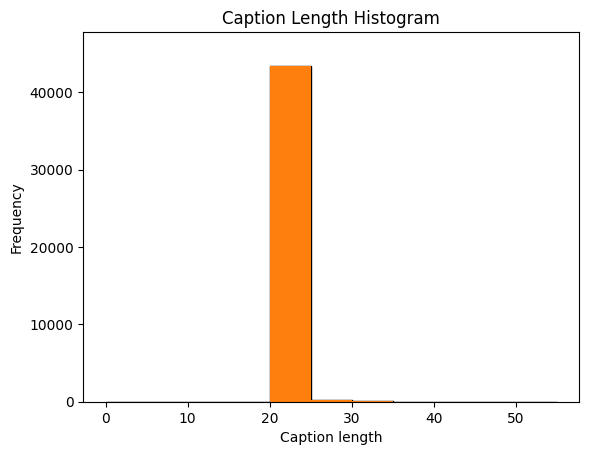

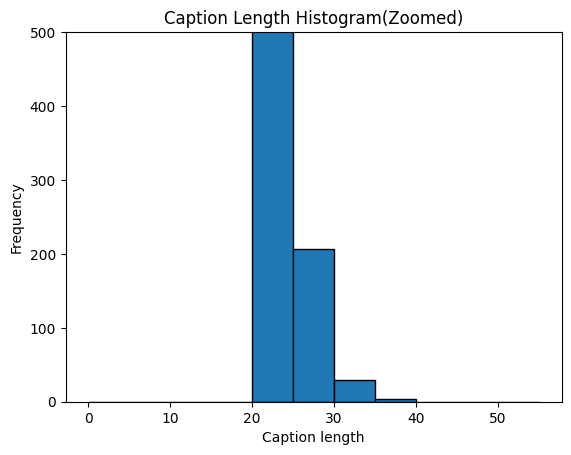

In [6]:
caption_stats_train = Caption_Stats(train_constrained, train_unconstrained, vocab_len)
caption_stats_train.vocab_coverage_oov()
caption_stats_train.length_histogram()

### OOV, Vocabulary coverage and Length Histogram for validation dataset

Number of unknown tokens: 487
Total number of tokens = 2832
Vocabulary Coverage = 0.8280367231638418
OOV% = 0.1719632768361582%


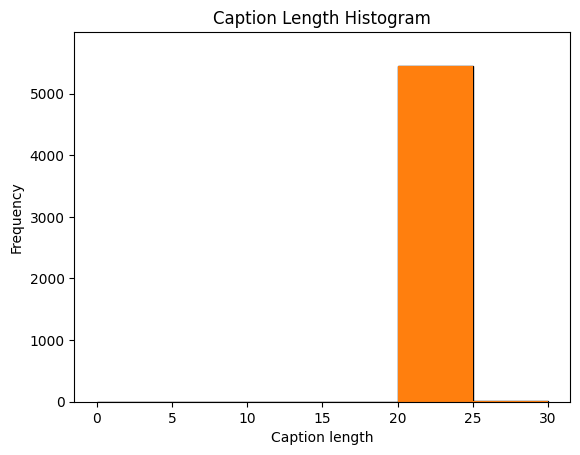

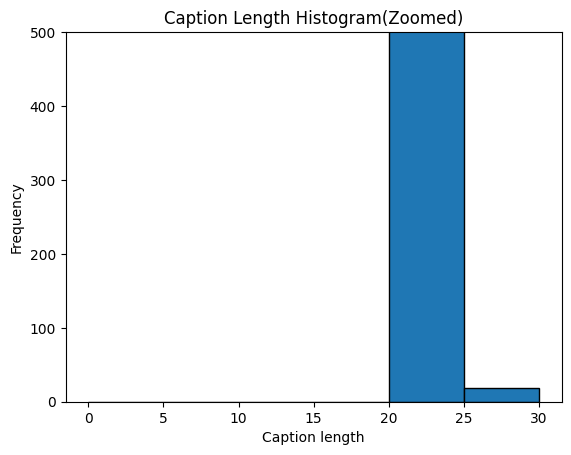

In [7]:
caption_stats_train = Caption_Stats(vals_constrained, vals_unconstrained, vocab_len)
caption_stats_train.vocab_coverage_oov()
caption_stats_train.length_histogram()

### OOV, Vocabulary coverage and Length Histogram for validation dataset

Number of unknown tokens: 846
Total number of tokens = 2832
Vocabulary Coverage = 0.701271186440678
OOV% = 0.298728813559322%


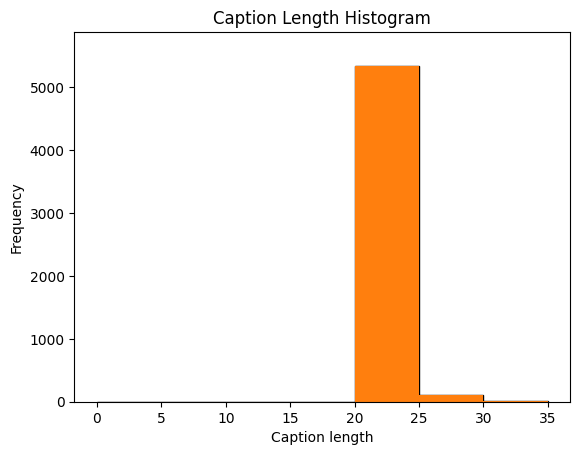

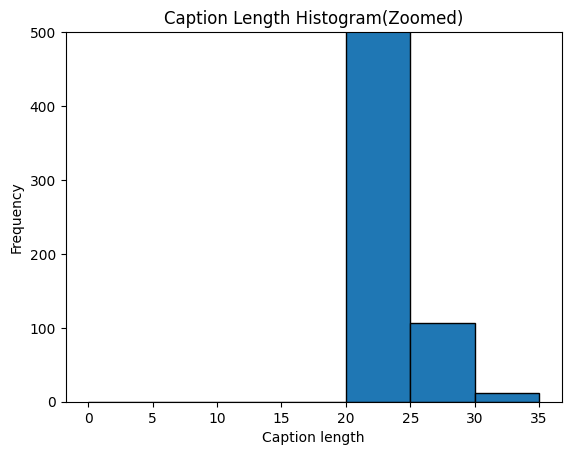

In [8]:
caption_stats_train = Caption_Stats(test_constrained, test_unconstrained, vocab_len)
caption_stats_train.vocab_coverage_oov()
caption_stats_train.length_histogram()

### Dataset Class that preprocesses the image

In [9]:
class TransformedImageCaptionDataset(Dataset):
    def __init__(self, dataframe, constrained_id):
        super().__init__()   

        def tensor_conversion(byte_info):
            img_dict = ast.literal_eval(byte_info)
            image_bytes = img_dict['bytes']
            image = Image.open(io.BytesIO(image_bytes)).convert("RGB")
            return torch.tensor(np.array(image))
        
        transforms = v2.Compose([
            v2.ToDtype(torch.float32, scale = True),
            v2.Normalize(mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225]),
        ])

        self.dataframe = dataframe
        self.tensor_conversion = tensor_conversion
        self.transforms = transforms
        self.constraint_tokenized = constrained_id
        
    def __len__(self):
        return len(self.dataframe)
    
    def __getitem__(self, idx):
        image = self.transforms(self.tensor_conversion(self.dataframe.iloc[idx]['image']).reshape(3, 224, 224))
        tokenized_captions = torch.tensor(self.constraint_tokenized[idx], dtype = torch.long)[0]
        return tokenized_captions, image, idx

In [10]:
train_transformed_img_dataset = TransformedImageCaptionDataset(train_df, train_constrained)
valid_transformed_img_dataset = TransformedImageCaptionDataset(valid_df, vals_constrained)
test_transformed_img_dataset = TransformedImageCaptionDataset(test_df, test_constrained)

In [31]:
test_transformed_img_dataset[0]

(tensor([  1,  12,  58,  15, 145,  35,   4,   2,   0,   0,   0,   0,   0,   0,
           0,   0,   0,   0,   0,   0,   0,   0]),
 tensor([[[-0.2856, -0.2684, -0.3541,  ..., -0.1143,  0.0741, -0.0972],
          [-0.1314,  0.0912, -0.0801,  ...,  0.2624,  0.1426,  0.2624],
          [ 0.2624,  0.1254,  0.2624,  ...,  0.2111,  0.1939,  0.1254],
          ...,
          [-0.0801, -0.1143,  0.0741,  ...,  0.2796,  0.2111,  0.0227],
          [-0.5596, -0.5424, -0.6452,  ..., -0.0972,  0.0398, -0.0972],
          [-0.1314,  0.1083, -0.0287,  ..., -0.1486, -0.1828,  0.0569]],
 
         [[ 0.0476,  0.0126,  0.2227,  ...,  0.3803,  0.3102,  0.1176],
          [-0.3725, -0.3550, -0.4601,  ...,  0.0651,  0.2227,  0.0826],
          [ 0.0476,  0.2927,  0.1527,  ..., -0.0399, -0.0924,  0.1352],
          ...,
          [-0.2850, -0.1800, -0.3200,  ...,  0.0476, -0.0574,  0.1702],
          [ 0.0476, -0.0574,  0.1176,  ...,  0.4153,  0.3452,  0.3277],
          [-0.0399, -0.0924, -0.2150,  ..., -

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9577876].


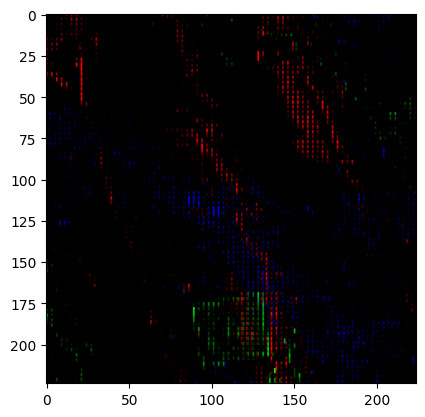

In [11]:
plt.imshow(train_transformed_img_dataset[5000][1].permute(2, 1, 0))

### Using ResNet-18 as image encoder

In [12]:
resnet18 = torchvision.models.resnet18(weights = 'IMAGENET1K_V1')
print(resnet18)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [13]:
layers = list(resnet18.children())[:-1]
resnet18 = nn.Sequential(*layers)

In [14]:
mobilenet_v2 = torchvision.models.mobilenet_v2(weights = 'IMAGENET1K_V1')
print(mobilenet_v2)

MobileNetV2(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU6(inplace=True)
        )
        (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (2): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(96, eps=

In [15]:
mobilenet_v2 = nn.Sequential(mobilenet_v2.features, nn.AdaptiveAvgPool2d((1, 1)))

In [16]:
train_loader_for_features = DataLoader(train_transformed_img_dataset, batch_size = 32, shuffle = True)
valid_loader_for_features = DataLoader(valid_transformed_img_dataset, batch_size = 32, shuffle = False)
test_loader_for_features = DataLoader(test_transformed_img_dataset, batch_size = 32, shuffle = False)

In [17]:
train_features_resnet = {}
valid_features_resnet = {}
test_features_resnet = {}
train_features_mobilenet = {}
valid_features_mobilenet = {}
test_features_mobilenet = {}

features_list_resnet = [train_features_resnet, valid_features_resnet, test_features_resnet]
features_list_mobilenet = [train_features_mobilenet, valid_features_mobilenet, test_features_mobilenet]
loader_list = [train_loader_for_features, valid_loader_for_features, test_loader_for_features]

resnet18.eval()
with torch.no_grad():
    for i, loader in enumerate(loader_list):
        for cap, imgs, idxs in loader:
            out = resnet18(imgs)
            out = out.view(out.shape[0], -1) 
            for local_idx, global_idx in enumerate(idxs):
                features_list_resnet[i][global_idx.item()] = out[local_idx].cpu()

mobilenet_v2.eval()
with torch.no_grad():
    for i, loader in enumerate(loader_list):
        for cap, imgs, idxs in loader:
            out = mobilenet_v2(imgs)
            out = out.view(out.shape[0], -1) 
            for local_idx, global_idx in enumerate(idxs):
                features_list_mobilenet[i][global_idx.item()] = out[local_idx].cpu()

torch.save(features_list_resnet[0], "train_features_resnet.pt")
torch.save(features_list_resnet[1], "valid_features_resnet.pt")
torch.save(features_list_resnet[2], "test_features_resnet.pt")

torch.save(features_list_mobilenet[0], "train_features_mobilenet.pt")
torch.save(features_list_mobilenet[1], "valid_features_mobilenet.pt")
torch.save(features_list_mobilenet[2], "test_features_mobilenet.pt")

### LSTM Decoder

In [ ]:
#[1]
class LSTM_Decoder(nn.Module):
    def __init__(self, img_feature_dim, embedding_dim, hidden_size, vocab_size,
                 num_layers=1, dropout_rate=0.3, pad_idx=0):
        super(LSTM_Decoder, self).__init__()

        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.vocab_size = vocab_size
        self.pad_idx = pad_idx

        # Token embedding
        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx=pad_idx)

        # Project image features to initial hidden and cell states
        self.init_h = nn.Linear(img_feature_dim, hidden_size * num_layers)
        self.init_c = nn.Linear(img_feature_dim, hidden_size * num_layers)

        # LSTM
        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_rate if num_layers > 1 else 0
        )

        # Output classifier
        self.classifier = nn.Linear(hidden_size, vocab_size)
        self.dropout = nn.Dropout(dropout_rate)

    def forward(self, captions, img_features, teacher_forcing=True):
        """
        captions: [B, seq_len] token IDs
        img_features: [B, img_feature_dim]
        teacher_forcing: True for training, False for inference
        """
        B, seq_len = captions.shape

        # Embed captions
        embeddings = self.embedding(captions)  # [B, seq_len, embedding_dim]
        embeddings = self.dropout(embeddings)

        # Initialize hidden and cell states from image features
        h0 = self.init_h(img_features).view(self.num_layers, B, self.hidden_size)
        c0 = self.init_c(img_features).view(self.num_layers, B, self.hidden_size)

        # Teacher forcing (training)
        if teacher_forcing:
            lstm_out, _ = self.lstm(embeddings, (h0, c0))       # [B, seq_len, hidden_size]
            logits = self.classifier(lstm_out)                  # [B, seq_len, vocab_size]
            return logits

        # Greedy inference (step-by-step)
        else:
            outputs = []
            input_token = captions[:, 0].unsqueeze(1)  # usually <BOS>
            hidden = (h0, c0)

            for t in range(seq_len):
                embed = self.embedding(input_token)            # [B, 1, embedding_dim]
                lstm_out, hidden = self.lstm(embed, hidden)   # [B, 1, hidden_size]
                logit = self.classifier(lstm_out.squeeze(1))  # [B, vocab_size]
                outputs.append(logit.unsqueeze(1))
                # Next input token: greedy argmax
                input_token = logit.argmax(dim=1).unsqueeze(1)

            return torch.cat(outputs, dim=1)  # [B, seq_len, vocab_size]

### Dataset class for image features

In [19]:
class DatasetWithImageFeatures(Dataset):
    def __init__(self, captions, img_features):
        super().__init__()
        self.captions = captions
        self.img_features = img_features
    
    def __len__(self):
        return len(self.img_features)
    
    def __getitem__(self, idx):
        return torch.tensor(self.captions[idx])[0], self.img_features[idx]

In [20]:
# For ResNet18 features
train_dataset_with_features_resnet = DatasetWithImageFeatures(train_constrained, train_features_resnet)
valid_dataset_with_features_resnet = DatasetWithImageFeatures(vals_constrained, valid_features_resnet)
test_dataset_with_features_resnet = DatasetWithImageFeatures(test_constrained, test_features_resnet)
train_loader_with_features_resnet = DataLoader(train_dataset_with_features_resnet, batch_size = 32, shuffle = True)
valid_loader_with_features_resnet = DataLoader(valid_dataset_with_features_resnet, batch_size = 32, shuffle = False)
test_loader_with_features_resnet = DataLoader(test_dataset_with_features_resnet, batch_size = 32, shuffle = False)

# For MobileNetV2 features
train_dataset_with_features_mobilenet = DatasetWithImageFeatures(train_constrained, train_features_mobilenet)
valid_dataset_with_features_mobilenet = DatasetWithImageFeatures(vals_constrained, valid_features_mobilenet)
test_dataset_with_features_mobilenet = DatasetWithImageFeatures(test_constrained, test_features_mobilenet)
train_loader_with_features_mobilenet = DataLoader(train_dataset_with_features_mobilenet, batch_size = 32, shuffle = True)
valid_loader_with_features_mobilenet = DataLoader(valid_dataset_with_features_mobilenet, batch_size = 32, shuffle = False)
test_loader_with_features_mobilenet = DataLoader(test_dataset_with_features_mobilenet, batch_size = 32, shuffle = False)

### Training the LSTM with features extracted by ResNet18

In [ ]:
#[1]
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Decoder
decoder = LSTM_Decoder(
    img_feature_dim=512,
    embedding_dim=512,
    hidden_size=512,
    vocab_size=2832,
    num_layers=1,
    dropout_rate=0.3,
    pad_idx=0
).to(device)

loss_fn = nn.CrossEntropyLoss(ignore_index=0)
optimizer = torch.optim.Adam(decoder.parameters(), lr=2e-4)

num_epochs = 20

for epoch in range(num_epochs):
    decoder.train()
    epoch_loss = 0.0
    
    for captions, img_features in train_loader_with_features_resnet:
        captions = captions.to(device)         # [B, seq_len]
        img_features = img_features.to(device) # [B, feature_dim]

        # Shift captions for teacher forcing
        input_captions = captions[:, :-1]  # [B, seq_len-1], feed into LSTM
        targets = captions[:, 1:]          # [B, seq_len-1], predict next token

        # Forward pass
        logits = decoder(input_captions, img_features, teacher_forcing=True)  # [B, seq_len-1, vocab_size]

        # Compute loss
        loss = loss_fn(
            logits.reshape(-1, logits.size(-1)),  # [(B*(seq_len-1)), vocab_size]
            targets.reshape(-1)                   # [(B*(seq_len-1))]
        )

        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    avg_loss = epoch_loss / len(train_loader_with_features_resnet)
    print(f"Epoch [{epoch+1}/{num_epochs}], Avg Loss: {avg_loss:.4f}")

Epoch [1/20], Avg Loss: 3.6134
Epoch [2/20], Avg Loss: 2.3886
Epoch [3/20], Avg Loss: 2.1000
Epoch [4/20], Avg Loss: 1.9241
Epoch [5/20], Avg Loss: 1.7998
Epoch [6/20], Avg Loss: 1.7022
Epoch [7/20], Avg Loss: 1.6201
Epoch [8/20], Avg Loss: 1.5512
Epoch [9/20], Avg Loss: 1.4898
Epoch [10/20], Avg Loss: 1.4364
Epoch [11/20], Avg Loss: 1.3838
Epoch [12/20], Avg Loss: 1.3388
Epoch [13/20], Avg Loss: 1.2941
Epoch [14/20], Avg Loss: 1.2557
Epoch [15/20], Avg Loss: 1.2177
Epoch [16/20], Avg Loss: 1.1808
Epoch [17/20], Avg Loss: 1.1484
Epoch [18/20], Avg Loss: 1.1153
Epoch [19/20], Avg Loss: 1.0870
Epoch [20/20], Avg Loss: 1.0576


### Index to word converter

In [22]:
idx_to_word_dict = {}

for key, value in tokenizer.vocab.items():
    idx_to_word_dict[value] = key

## Evaluation and Analysis

### Metrics for Resnet18 + LSTM(BLEU-4, METEOR, Caption Length Stats, % of degenerate repetitions) 

In [23]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
from collections import Counter

In [ ]:
#[1]
decoder.eval()
device = next(decoder.parameters()).device

smooth_fn = SmoothingFunction().method1

bleu_scores = []
meteor_scores = []
lengths = []
degenerate_counts = []

for captions, img_features in valid_loader_with_features_resnet:
    captions = captions.to(device)         # [B, seq_len]
    img_features = img_features.to(device) # [B, feature_dim]
    B = captions.size(0)

    # Initialize hidden/cell
    h0 = decoder.init_h(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    c0 = decoder.init_c(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    hidden = (h0, c0)

    # <BOS> token
    input_token = torch.full((B,1), 1, device=device, dtype=torch.long)  

    pred_tokens = []

    # Greedy decoding
    max_len = captions.size(1)
    for t in range(max_len):
        embed = decoder.embedding(input_token)
        lstm_out, hidden = decoder.lstm(embed, hidden)
        logit = decoder.classifier(lstm_out.squeeze(1))
        input_token = logit.argmax(dim=1).unsqueeze(1)
        pred_tokens.append(input_token)
        # stop if all EOS
        if (input_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1).cpu().numpy()
    captions_np = captions.cpu().numpy()

    # Convert to words and compute metrics
    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]

        # BLEU-4
        bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

        # METEOR
        meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

        # Caption length
        lengths.append(len(pred_tokens_i))

        # Degenerate repetition: >=3 identical tokens in a row
        count = 0
        for j in range(len(pred_tokens_i)-2):
            if pred_tokens_i[j] == pred_tokens_i[j+1] == pred_tokens_i[j+2]:
                count += 1
        degenerate_counts.append(count)

# --- Report ---
print(f"Validation Metrics (ResNet18 + LSTM):")
print(f"Avg BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"Avg METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: mean={np.mean(lengths):.2f}, std={np.std(lengths):.2f}")
print(f"Degenerate repetitions per caption (mean): {np.mean(degenerate_counts):.2f}")
print(f"% captions with degenerate repetitions: {100*np.mean([c>0 for c in degenerate_counts]):.2f}%")

Validation Metrics (ResNet18 + LSTM):
Avg BLEU-4: 0.0702
Avg METEOR: 0.2502
Caption length: mean=14.11, std=1.64
Degenerate repetitions per caption (mean): 1.52
% captions with degenerate repetitions: 88.67%


In [ ]:
#[1]
bleu_scores = []
meteor_scores = []
lengths = []
degenerate_counts = []

for captions, img_features in test_loader_with_features_resnet:
    captions = captions.to(device)         # [B, seq_len]
    img_features = img_features.to(device) # [B, feature_dim]
    B = captions.size(0)

    # Initialize hidden/cell
    h0 = decoder.init_h(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    c0 = decoder.init_c(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    hidden = (h0, c0)

    # <BOS> token
    input_token = torch.full((B,1), 1, device=device, dtype=torch.long)  

    pred_tokens = []

    # Greedy decoding
    max_len = captions.size(1)
    for t in range(max_len):
        embed = decoder.embedding(input_token)
        lstm_out, hidden = decoder.lstm(embed, hidden)
        logit = decoder.classifier(lstm_out.squeeze(1))
        input_token = logit.argmax(dim=1).unsqueeze(1)
        pred_tokens.append(input_token)
        # stop if all EOS
        if (input_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1).cpu().numpy()
    captions_np = captions.cpu().numpy()

    # Convert to words and compute metrics
    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]

        # BLEU-4
        bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

        # METEOR
        meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

        # Caption length
        lengths.append(len(pred_tokens_i))

        # Degenerate repetition: >=3 identical tokens in a row
        count = 0
        for j in range(len(pred_tokens_i)-2):
            if pred_tokens_i[j] == pred_tokens_i[j+1] == pred_tokens_i[j+2]:
                count += 1
        degenerate_counts.append(count)

# --- Report ---
print(f"Testing Metrics (ResNet18 + LSTM):")
print(f"Avg BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"Avg METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: mean={np.mean(lengths):.2f}, std={np.std(lengths):.2f}")
print(f"Degenerate repetitions per caption (mean): {np.mean(degenerate_counts):.2f}")
print(f"% captions with degenerate repetitions: {100*np.mean([c>0 for c in degenerate_counts]):.2f}%")

Testing Metrics (ResNet18 + LSTM):
Avg BLEU-4: 0.0265
Avg METEOR: 0.1623
Caption length: mean=14.10, std=1.58
Degenerate repetitions per caption (mean): 1.51
% captions with degenerate repetitions: 88.66%


| Metric                        | Validation (ResNet18+LSTM) | Testing (ResNet18+LSTM) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.0702                | 0.0265                        |
| Avg METEOR                    | 0.2502                  | 0.1623                        |
| Caption length (mean ± std)   | 14.11 ± 1.64            | 14.10 ± 1.58                   |
| Degenerate repetitions (mean) | 1.52                  | 1.51                         |
| % captions with degeneracy    | 88.67%                | 88.66%                        |


In [26]:
import textwrap

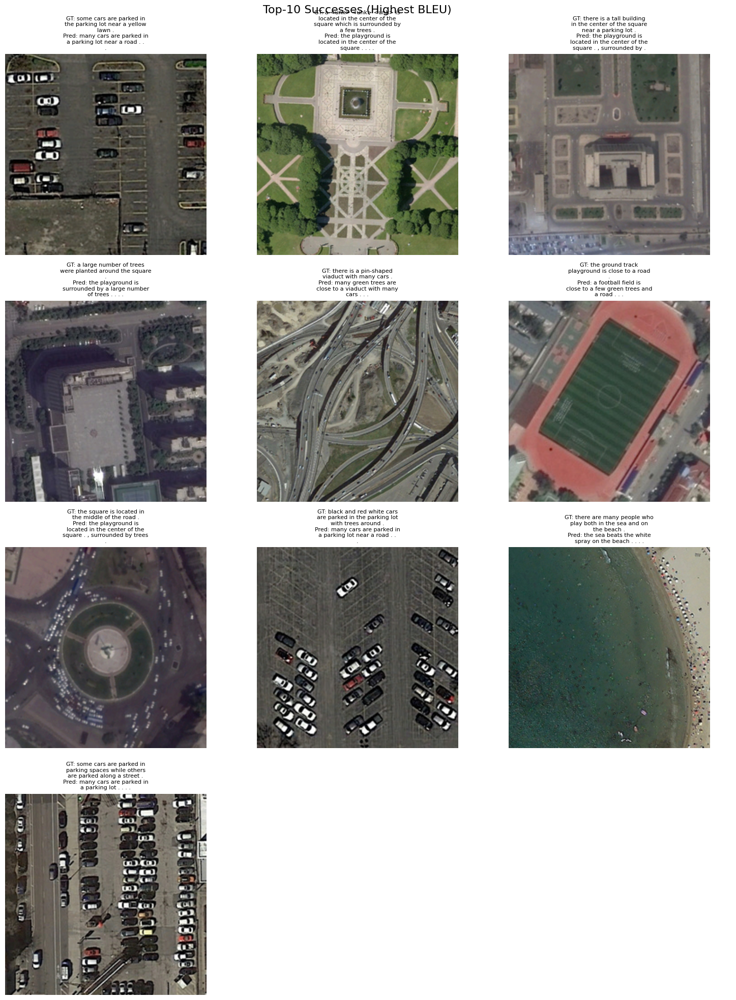

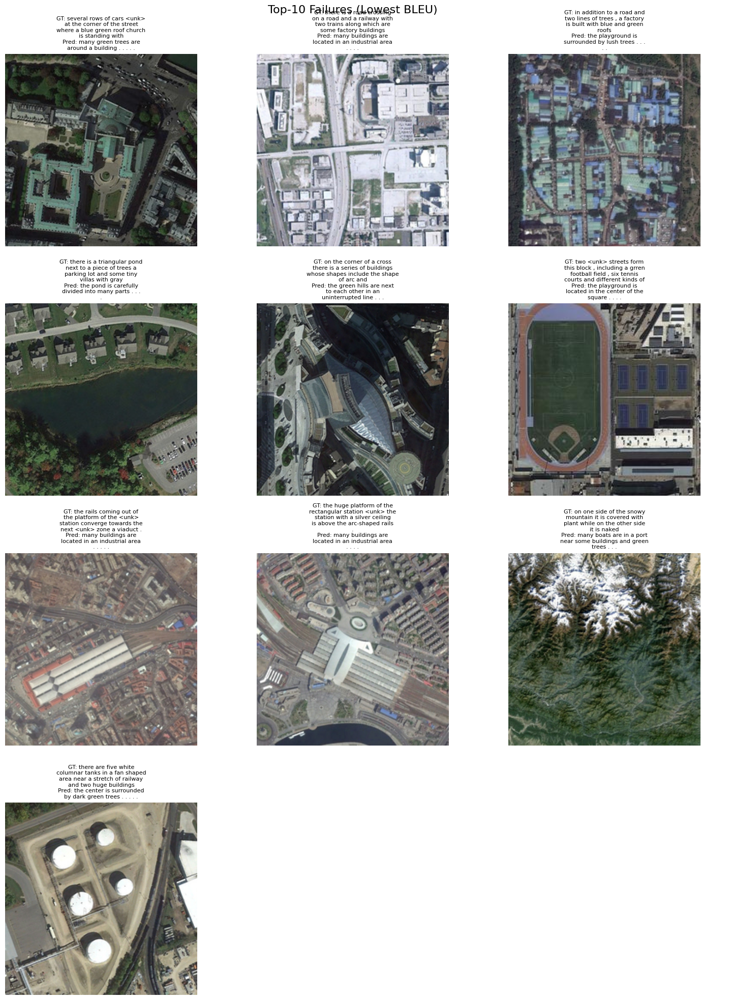

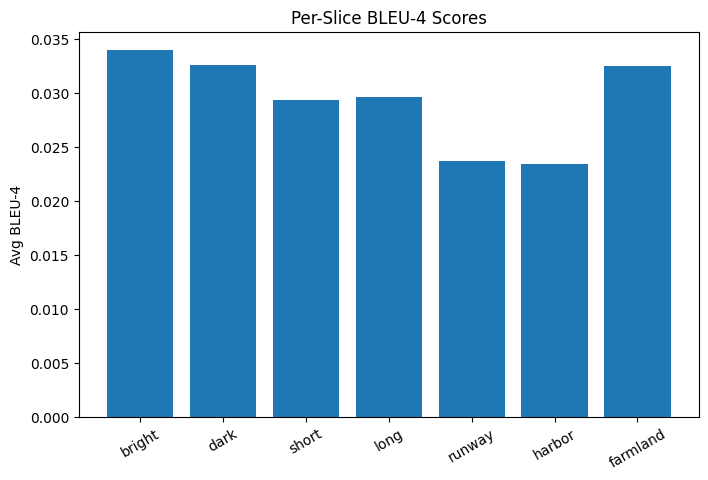

In [ ]:
#[1]
import io, ast
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import torch

smooth_fn = SmoothingFunction().method4

# --- Helper: decode raw image using dataset + index ---
def load_raw_image(dataset, idx):
    """
    dataset: the dataset object (ImageFolder-like or custom) 
             where each item gives (caption, image_bytes, index)
    idx: integer index from dataset
    """

    byte_info = dataset.iloc[idx]['image']   # assuming 2nd field = image bytes dict/string
    if isinstance(byte_info, str):
        img_dict = ast.literal_eval(byte_info)  # parse string to dict
    else:
        img_dict = byte_info
    image_bytes = img_dict['bytes']
    image = Image.open(io.BytesIO(image_bytes)).convert("RGB")
    return image

# --- 1. Collect predictions & metrics ---
all_examples = []

for (captions, img_features), (_, _, indices) in zip(test_loader_with_features_resnet, test_loader_for_features):
    captions = captions.to(device)
    img_features = img_features.to(device)
    B = captions.size(0)

    # Greedy decode
    h0 = decoder.init_h(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    c0 = decoder.init_c(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    hidden = (h0, c0)
    input_token = torch.full((B,1), 1, device=device, dtype=torch.long)  # <BOS> token

    pred_tokens = []
    for t in range(captions.size(1)):
        embed = decoder.embedding(input_token)
        lstm_out, hidden = decoder.lstm(embed, hidden)
        logit = decoder.classifier(lstm_out.squeeze(1))
        input_token = logit.argmax(dim=1).unsqueeze(1)
        pred_tokens.append(input_token)
        if (input_token.squeeze(1) == 2).all():  # <EOS> token
            break

    pred_tokens = torch.cat(pred_tokens, dim=1).cpu().numpy()
    captions_np = captions.cpu().numpy()

    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]
        bleu = sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn)

        all_examples.append({
            "index": indices[i].item(),        # keep index for raw access
            "gt": " ".join(gt_tokens),
            "pred": " ".join(pred_tokens_i),
            "bleu": bleu,
            "len_gt": len(gt_tokens)
        })

# --- 2. Pick 10 successes and 10 failures ---
all_examples.sort(key=lambda x: x["bleu"], reverse=True)
successes = all_examples[:10]
failures = all_examples[-10:]

def show_examples(examples, title, dataset, cols=3):
    """
    examples: list of dicts with keys 'index', 'gt', 'pred'
    dataset: DataFrame with 'image' column
    cols: number of columns in the figure
    """
    rows = (len(examples) + cols - 1) // cols  # ceiling division
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    axes = axes.flatten()
    fig.suptitle(title, fontsize=16)
    
    for ax, ex in zip(axes, examples):
        raw_img = load_raw_image(dataset, ex["index"])
        ax.imshow(raw_img)
        ax.axis("off")
        
        # Wrap long text
        gt_wrapped = "\n".join(textwrap.wrap(f"GT: {ex['gt']}", width=30))
        pred_wrapped = "\n".join(textwrap.wrap(f"Pred: {ex['pred']}", width=30))
        ax.set_title(f"{gt_wrapped}\n{pred_wrapped}", fontsize=8)
    
    # Turn off any unused axes
    for ax in axes[len(examples):]:
        ax.axis("off")
    
    plt.tight_layout()
    plt.show()

# Pass the dataset you used in dataloader
show_examples(successes, "Top-10 Successes (Highest BLEU)", test_df)
show_examples(failures, "Top-10 Failures (Lowest BLEU)", test_df)

# --- 3. Slice Analysis ---
slice_bleus = {"bright": [], "dark": [], "short": [], "long": [], 
               "runway": [], "harbor": [], "farmland": []}

for ex in all_examples:
    raw_img = load_raw_image(test_df, ex["index"])
    mean_brightness = np.array(raw_img).mean() / 255.0
    # Bright vs Dark
    if mean_brightness > 0.6:
        slice_bleus["bright"].append(ex["bleu"])
    else:
        slice_bleus["dark"].append(ex["bleu"])
    # Caption length
    if ex["len_gt"] <= 8:
        slice_bleus["short"].append(ex["bleu"])
    elif ex["len_gt"] >= 16:
        slice_bleus["long"].append(ex["bleu"])
    # Scene keywords
    if "runway" in ex["gt"]:
        slice_bleus["runway"].append(ex["bleu"])
    if "harbor" in ex["gt"]:
        slice_bleus["harbor"].append(ex["bleu"])
    if "farmland" in ex["gt"]:
        slice_bleus["farmland"].append(ex["bleu"])

# --- 4. Average BLEU per slice ---
slice_avg_bleus = {k: (np.mean(v) if len(v)>0 else 0) for k,v in slice_bleus.items()}

plt.figure(figsize=(8,5))
plt.bar(slice_avg_bleus.keys(), slice_avg_bleus.values())
plt.ylabel("Avg BLEU-4")
plt.title("Per-Slice BLEU-4 Scores")
plt.xticks(rotation=30)
plt.show()

### Training LSTM on features extracted using MobileNet

In [35]:
train_features_mobilenet[0].shape

torch.Size([1280])

In [ ]:
#[1]
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Decoder
decoder = LSTM_Decoder(
    img_feature_dim=1280,
    embedding_dim=512,
    hidden_size=512,
    vocab_size=2832,
    num_layers=1,
    dropout_rate=0.3,
    pad_idx=0
).to(device)

loss_fn = nn.CrossEntropyLoss(ignore_index=0)
optimizer = torch.optim.Adam(decoder.parameters(), lr=2e-4)

num_epochs = 20

for epoch in range(num_epochs):
    decoder.train()
    epoch_loss = 0.0
    
    for captions, img_features in train_loader_with_features_mobilenet:
        captions = captions.to(device)         # [B, seq_len]
        img_features = img_features.to(device) # [B, feature_dim]

        # Shift captions for teacher forcing
        input_captions = captions[:, :-1]  # [B, seq_len-1], feed into LSTM
        targets = captions[:, 1:]          # [B, seq_len-1], predict next token

        # Forward pass
        logits = decoder(input_captions, img_features, teacher_forcing=True)  # [B, seq_len-1, vocab_size]

        # Compute loss
        loss = loss_fn(
            logits.reshape(-1, logits.size(-1)),  # [(B*(seq_len-1)), vocab_size]
            targets.reshape(-1)                   # [(B*(seq_len-1))]
        )

        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    avg_loss = epoch_loss / len(train_loader_with_features_mobilenet)
    print(f"Epoch [{epoch+1}/{num_epochs}], Avg Loss: {avg_loss:.4f}")

Epoch [1/20], Avg Loss: 3.5919
Epoch [2/20], Avg Loss: 2.3656
Epoch [3/20], Avg Loss: 2.0717
Epoch [4/20], Avg Loss: 1.8941
Epoch [5/20], Avg Loss: 1.7668
Epoch [6/20], Avg Loss: 1.6690
Epoch [7/20], Avg Loss: 1.5880
Epoch [8/20], Avg Loss: 1.5165
Epoch [9/20], Avg Loss: 1.4544
Epoch [10/20], Avg Loss: 1.3976
Epoch [11/20], Avg Loss: 1.3472
Epoch [12/20], Avg Loss: 1.2990
Epoch [13/20], Avg Loss: 1.2535
Epoch [14/20], Avg Loss: 1.2130
Epoch [15/20], Avg Loss: 1.1733
Epoch [16/20], Avg Loss: 1.1359
Epoch [17/20], Avg Loss: 1.1003
Epoch [18/20], Avg Loss: 1.0664
Epoch [19/20], Avg Loss: 1.0330
Epoch [20/20], Avg Loss: 1.0028


### Metrics for MobileNet + LSTM(BLEU-4, METEOR, Caption Length Stats, % of degenerate repetitions) on Validation

In [ ]:
#[1]
decoder.eval()
device = next(decoder.parameters()).device

smooth_fn = SmoothingFunction().method1

bleu_scores = []
meteor_scores = []
lengths = []
degenerate_counts = []

for captions, img_features in valid_loader_with_features_mobilenet:
    captions = captions.to(device)         # [B, seq_len]
    img_features = img_features.to(device) # [B, feature_dim]
    B = captions.size(0)

    # Initialize hidden/cell
    h0 = decoder.init_h(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    c0 = decoder.init_c(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    hidden = (h0, c0)

    # <BOS> token
    input_token = torch.full((B,1), 1, device=device, dtype=torch.long)  

    pred_tokens = []

    # Greedy decoding
    max_len = captions.size(1)
    for t in range(max_len):
        embed = decoder.embedding(input_token)
        lstm_out, hidden = decoder.lstm(embed, hidden)
        logit = decoder.classifier(lstm_out.squeeze(1))
        input_token = logit.argmax(dim=1).unsqueeze(1)
        pred_tokens.append(input_token)
        # stop if all EOS
        if (input_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1).cpu().numpy()
    captions_np = captions.cpu().numpy()

    # Convert to words and compute metrics
    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]

        # BLEU-4
        bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

        # METEOR
        meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

        # Caption length
        lengths.append(len(pred_tokens_i))

        # Degenerate repetition: >=3 identical tokens in a row
        count = 0
        for j in range(len(pred_tokens_i)-2):
            if pred_tokens_i[j] == pred_tokens_i[j+1] == pred_tokens_i[j+2]:
                count += 1
        degenerate_counts.append(count)

# --- Report ---
print(f"Validation Metrics (MobileNet + LSTM):")
print(f"Avg BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"Avg METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: mean={np.mean(lengths):.2f}, std={np.std(lengths):.2f}")
print(f"Degenerate repetitions per caption (mean): {np.mean(degenerate_counts):.2f}")
print(f"% captions with degenerate repetitions: {100*np.mean([c>0 for c in degenerate_counts]):.2f}%")

Validation Metrics (MobileNet + LSTM):
Avg BLEU-4: 0.1028
Avg METEOR: 0.2868
Caption length: mean=11.37, std=2.40
Degenerate repetitions per caption (mean): 0.00
% captions with degenerate repetitions: 0.00%


In [ ]:
#[1]
decoder.eval()
device = next(decoder.parameters()).device

smooth_fn = SmoothingFunction().method1

bleu_scores = []
meteor_scores = []
lengths = []
degenerate_counts = []

for captions, img_features in test_loader_with_features_mobilenet:
    captions = captions.to(device)         # [B, seq_len]
    img_features = img_features.to(device) # [B, feature_dim]
    B = captions.size(0)

    # Initialize hidden/cell
    h0 = decoder.init_h(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    c0 = decoder.init_c(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    hidden = (h0, c0)

    # <BOS> token
    input_token = torch.full((B,1), 1, device=device, dtype=torch.long)  

    pred_tokens = []

    # Greedy decoding
    max_len = captions.size(1)
    for t in range(max_len):
        embed = decoder.embedding(input_token)
        lstm_out, hidden = decoder.lstm(embed, hidden)
        logit = decoder.classifier(lstm_out.squeeze(1))
        input_token = logit.argmax(dim=1).unsqueeze(1)
        pred_tokens.append(input_token)
        # stop if all EOS
        if (input_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1).cpu().numpy()
    captions_np = captions.cpu().numpy()

    # Convert to words and compute metrics
    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]

        # BLEU-4
        bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

        # METEOR
        meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

        # Caption length
        lengths.append(len(pred_tokens_i))

        # Degenerate repetition: >=3 identical tokens in a row
        count = 0
        for j in range(len(pred_tokens_i)-2):
            if pred_tokens_i[j] == pred_tokens_i[j+1] == pred_tokens_i[j+2]:
                count += 1
        degenerate_counts.append(count)

# --- Report ---
print(f"Testing Metrics (MobileNet + LSTM):")
print(f"Avg BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"Avg METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: mean={np.mean(lengths):.2f}, std={np.std(lengths):.2f}")
print(f"Degenerate repetitions per caption (mean): {np.mean(degenerate_counts):.2f}")
print(f"% captions with degenerate repetitions: {100*np.mean([c>0 for c in degenerate_counts]):.2f}%")

Testing Metrics (MobileNet + LSTM):
Avg BLEU-4: 0.0286
Avg METEOR: 0.1669
Caption length: mean=11.43, std=2.44
Degenerate repetitions per caption (mean): 0.00
% captions with degenerate repetitions: 0.00%


| Metric                        | Validation (MobileNet+LSTM) | Testing (MobileNet+LSTM) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.1028              | 0.0286                        |
| Avg METEOR                    | 0.2868                  | 0.1669                        |
| Caption length (mean ± std)   | 11.37 ± 2.40            | 11.37 ± 2.44                  |
| Degenerate repetitions (mean) | 0.00                  | 0.00                         |
| % captions with degeneracy    | 0.00%                | 0.00%                        |

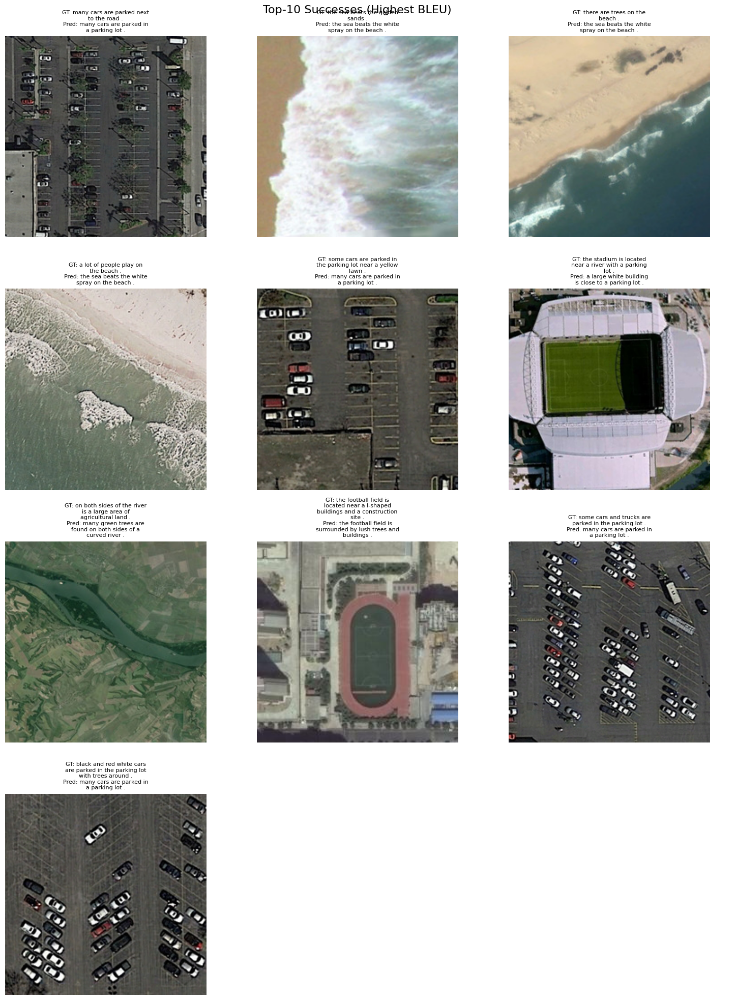

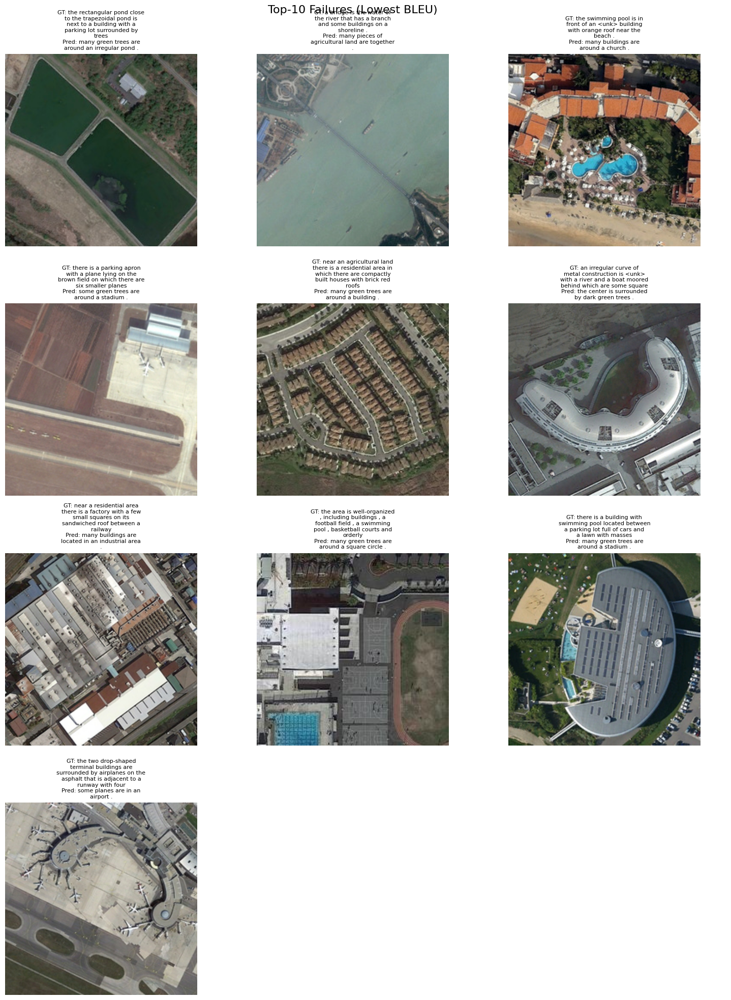

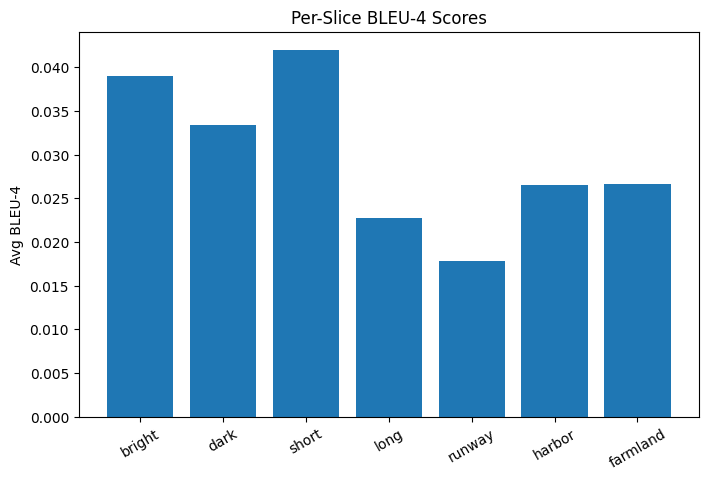

In [ ]:
#[1]
import io, ast
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import torch

smooth_fn = SmoothingFunction().method4

# --- Helper: decode raw image using dataset + index ---
def load_raw_image(dataset, idx):
    """
    dataset: the dataset object (ImageFolder-like or custom) 
             where each item gives (caption, image_bytes, index)
    idx: integer index from dataset
    """

    byte_info = dataset.iloc[idx]['image']   # assuming 2nd field = image bytes dict/string
    if isinstance(byte_info, str):
        img_dict = ast.literal_eval(byte_info)  # parse string to dict
    else:
        img_dict = byte_info
    image_bytes = img_dict['bytes']
    image = Image.open(io.BytesIO(image_bytes)).convert("RGB")
    return image

# --- 1. Collect predictions & metrics ---
all_examples = []

for (captions, img_features), (_, _, indices) in zip(test_loader_with_features_mobilenet, test_loader_for_features):
    captions = captions.to(device)
    img_features = img_features.to(device)
    B = captions.size(0)

    # Greedy decode
    h0 = decoder.init_h(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    c0 = decoder.init_c(img_features).view(decoder.num_layers, B, decoder.hidden_size)
    hidden = (h0, c0)
    input_token = torch.full((B,1), 1, device=device, dtype=torch.long)  # <BOS> token

    pred_tokens = []
    for t in range(captions.size(1)):
        embed = decoder.embedding(input_token)
        lstm_out, hidden = decoder.lstm(embed, hidden)
        logit = decoder.classifier(lstm_out.squeeze(1))
        input_token = logit.argmax(dim=1).unsqueeze(1)
        pred_tokens.append(input_token)
        if (input_token.squeeze(1) == 2).all():  # <EOS> token
            break

    pred_tokens = torch.cat(pred_tokens, dim=1).cpu().numpy()
    captions_np = captions.cpu().numpy()

    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]
        bleu = sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn)

        all_examples.append({
            "index": indices[i].item(),        # keep index for raw access
            "gt": " ".join(gt_tokens),
            "pred": " ".join(pred_tokens_i),
            "bleu": bleu,
            "len_gt": len(gt_tokens)
        })

# --- 2. Pick 10 successes and 10 failures ---
all_examples.sort(key=lambda x: x["bleu"], reverse=True)
successes = all_examples[:10]
failures = all_examples[-10:]

def show_examples(examples, title, dataset, cols=3):
    """
    examples: list of dicts with keys 'index', 'gt', 'pred'
    dataset: DataFrame with 'image' column
    cols: number of columns in the figure
    """
    rows = (len(examples) + cols - 1) // cols  # ceiling division
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    axes = axes.flatten()
    fig.suptitle(title, fontsize=16)
    
    for ax, ex in zip(axes, examples):
        raw_img = load_raw_image(dataset, ex["index"])
        ax.imshow(raw_img)
        ax.axis("off")
        
        # Wrap long text
        gt_wrapped = "\n".join(textwrap.wrap(f"GT: {ex['gt']}", width=30))
        pred_wrapped = "\n".join(textwrap.wrap(f"Pred: {ex['pred']}", width=30))
        ax.set_title(f"{gt_wrapped}\n{pred_wrapped}", fontsize=8)
    
    # Turn off any unused axes
    for ax in axes[len(examples):]:
        ax.axis("off")
    
    plt.tight_layout()
    plt.show()

# Pass the dataset you used in dataloader
show_examples(successes, "Top-10 Successes (Highest BLEU)", test_df)
show_examples(failures, "Top-10 Failures (Lowest BLEU)", test_df)

# --- 3. Slice Analysis ---
slice_bleus = {"bright": [], "dark": [], "short": [], "long": [], 
               "runway": [], "harbor": [], "farmland": []}

for ex in all_examples:
    raw_img = load_raw_image(test_df, ex["index"])
    mean_brightness = np.array(raw_img).mean() / 255.0
    # Bright vs Dark
    if mean_brightness > 0.6:
        slice_bleus["bright"].append(ex["bleu"])
    else:
        slice_bleus["dark"].append(ex["bleu"])
    # Caption length
    if ex["len_gt"] <= 8:
        slice_bleus["short"].append(ex["bleu"])
    elif ex["len_gt"] >= 16:
        slice_bleus["long"].append(ex["bleu"])
    # Scene keywords
    if "runway" in ex["gt"]:
        slice_bleus["runway"].append(ex["bleu"])
    if "harbor" in ex["gt"]:
        slice_bleus["harbor"].append(ex["bleu"])
    if "farmland" in ex["gt"]:
        slice_bleus["farmland"].append(ex["bleu"])

# --- 4. Average BLEU per slice ---
slice_avg_bleus = {k: (np.mean(v) if len(v)>0 else 0) for k,v in slice_bleus.items()}

plt.figure(figsize=(8,5))
plt.bar(slice_avg_bleus.keys(), slice_avg_bleus.values())
plt.ylabel("Avg BLEU-4")
plt.title("Per-Slice BLEU-4 Scores")
plt.xticks(rotation=30)
plt.show()

### Training the Transformer decoder

In [ ]:
#[1]
class TransformerDecoder(nn.Module):
    def __init__(self, vocab_size, d_model=512, nhead=8, num_layers=3,
                 img_feature_dim=512, mem_tokens=2, pad_idx=0, dropout=0.1, max_len=100):
        super().__init__()
        self.d_model = d_model
        self.pad_idx = pad_idx
        self.max_len = max_len

        # Token embedding
        self.embedding = nn.Embedding(vocab_size, d_model, padding_idx=pad_idx)
        # Learnable positional embedding
        self.pos_embedding = nn.Parameter(torch.zeros(1, max_len, d_model))

        # Project image features to memory tokens
        self.img_proj = nn.Linear(img_feature_dim, d_model * mem_tokens)
        self.mem_tokens = mem_tokens
        self.mem_norm = nn.LayerNorm(d_model)

        # Transformer decoder
        decoder_layer = nn.TransformerDecoderLayer(
            d_model=d_model, nhead=nhead, dim_feedforward=2048,
            dropout=dropout, batch_first=True
        )
        self.transformer_decoder = nn.TransformerDecoder(decoder_layer, num_layers=num_layers)

        # Output classifier
        self.classifier = nn.Linear(d_model, vocab_size)

    def forward(self, captions, img_features):
        
        B, seq_len = captions.shape

        # Embed tokens and add positional embeddings
        tok_emb = self.embedding(captions) + self.pos_embedding[:, :seq_len, :]

        # Project image features to memory tokens
        mem = self.img_proj(img_features)         # [B, d_model * mem_tokens]
        mem = mem.view(B, self.mem_tokens, self.d_model)
        mem = self.mem_norm(mem)

        # --- Transformer decoder ---
        # Causal mask to prevent attending to future tokens
        tgt_mask = torch.triu(torch.ones(seq_len, seq_len, device=captions.device), diagonal=1).bool()

        # Key padding mask to ignore padding tokens
        tgt_key_padding_mask = (captions == self.pad_idx)

        # Decoder output
        output = self.transformer_decoder(
            tgt=tok_emb,
            memory=mem,
            tgt_mask=tgt_mask,
            tgt_key_padding_mask=tgt_key_padding_mask
        )

        # Classifier to get vocab logits
        logits = self.classifier(output)  # [B, seq_len, vocab_size]
        return logits

In [ ]:
#[1]
from tqdm import tqdm

# --- 1. Setup ---
VOCAB_SIZE = 2832
D_MODEL = 512
IMG_FEATURE_DIM = 512
NHEAD = 8
NUM_LAYERS = 3
PAD_IDX = 0
NUM_EPOCHS = 20
LEARNING_RATE = 2e-4

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Instantiate the model
model = TransformerDecoder(
    vocab_size=VOCAB_SIZE,
    d_model=D_MODEL,
    nhead=NHEAD,
    num_layers=NUM_LAYERS,
    img_feature_dim=IMG_FEATURE_DIM,
    pad_idx=PAD_IDX
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=PAD_IDX)
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

# --- 2. Training Loop ---
for epoch in range(NUM_EPOCHS):
    model.train()
    epoch_loss = 0.0
    progress_bar = tqdm(train_loader_with_features_resnet, desc=f"Epoch {epoch+1}/{NUM_EPOCHS}")

    for captions, img_features in progress_bar:
        captions = captions.to(device)       # [B, seq_len]
        img_features = img_features.to(device)  # [B, 512]

        # Input: all tokens except last
        input_captions = captions[:, :-1]    # [B, seq_len-1]
        # Target: all tokens except first (<BOS>)
        target_captions = captions[:, 1:]    # [B, seq_len-1]

        optimizer.zero_grad()
        outputs = model(input_captions, img_features)  # [B, seq_len-1, vocab_size]

        # CrossEntropyLoss expects [N, C] and [N]
        loss = criterion(outputs.reshape(-1, VOCAB_SIZE), target_captions.reshape(-1))
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        progress_bar.set_postfix(loss=loss.item())

    avg_epoch_loss = epoch_loss / len(train_loader_with_features_resnet)
    print(f"End of Epoch {epoch+1}, Average Loss: {avg_epoch_loss:.4f}")

print("Training finished!")

Using device: cuda


Epoch 1/20: 100%|██████████| 273/273 [00:09<00:00, 29.06it/s, loss=2.16]


End of Epoch 1, Average Loss: 2.6683


Epoch 2/20: 100%|██████████| 273/273 [00:09<00:00, 29.01it/s, loss=1.78]


End of Epoch 2, Average Loss: 1.8479


Epoch 3/20: 100%|██████████| 273/273 [00:09<00:00, 27.71it/s, loss=1.77]


End of Epoch 3, Average Loss: 1.6141


Epoch 4/20: 100%|██████████| 273/273 [00:09<00:00, 27.92it/s, loss=1.57] 


End of Epoch 4, Average Loss: 1.4513


Epoch 5/20: 100%|██████████| 273/273 [00:09<00:00, 29.77it/s, loss=1.31] 


End of Epoch 5, Average Loss: 1.3213


Epoch 6/20: 100%|██████████| 273/273 [00:08<00:00, 30.43it/s, loss=1.04] 


End of Epoch 6, Average Loss: 1.2085


Epoch 7/20: 100%|██████████| 273/273 [00:09<00:00, 29.56it/s, loss=1.05] 


End of Epoch 7, Average Loss: 1.1059


Epoch 8/20: 100%|██████████| 273/273 [00:09<00:00, 28.00it/s, loss=1.27] 


End of Epoch 8, Average Loss: 1.0113


Epoch 9/20: 100%|██████████| 273/273 [00:09<00:00, 28.03it/s, loss=0.866]


End of Epoch 9, Average Loss: 0.9253


Epoch 10/20: 100%|██████████| 273/273 [00:09<00:00, 29.67it/s, loss=0.799]


End of Epoch 10, Average Loss: 0.8477


Epoch 11/20: 100%|██████████| 273/273 [00:09<00:00, 30.24it/s, loss=0.681]


End of Epoch 11, Average Loss: 0.7746


Epoch 12/20: 100%|██████████| 273/273 [00:09<00:00, 30.10it/s, loss=0.829]


End of Epoch 12, Average Loss: 0.7182


Epoch 13/20: 100%|██████████| 273/273 [00:09<00:00, 28.31it/s, loss=0.729]


End of Epoch 13, Average Loss: 0.6617


Epoch 14/20: 100%|██████████| 273/273 [00:09<00:00, 28.20it/s, loss=0.577]


End of Epoch 14, Average Loss: 0.6175


Epoch 15/20: 100%|██████████| 273/273 [00:09<00:00, 28.17it/s, loss=0.58] 


End of Epoch 15, Average Loss: 0.5776


Epoch 16/20: 100%|██████████| 273/273 [00:10<00:00, 24.82it/s, loss=0.56] 


End of Epoch 16, Average Loss: 0.5393


Epoch 17/20: 100%|██████████| 273/273 [00:11<00:00, 24.44it/s, loss=0.573]


End of Epoch 17, Average Loss: 0.5037


Epoch 18/20: 100%|██████████| 273/273 [00:09<00:00, 27.77it/s, loss=0.527]


End of Epoch 18, Average Loss: 0.4744


Epoch 19/20: 100%|██████████| 273/273 [00:09<00:00, 29.94it/s, loss=0.445]


End of Epoch 19, Average Loss: 0.4499


Epoch 20/20: 100%|██████████| 273/273 [00:09<00:00, 30.24it/s, loss=0.464]

End of Epoch 20, Average Loss: 0.4230
Training finished!


### Metrics using ResNet + Transformer architecture on Validation

In [ ]:
#[1]
smooth_fn = SmoothingFunction().method1

all_pred_tokens = []  # predicted token IDs from model
all_gt_tokens = []    # ground truth token IDs

# --- 1. Generate predictions for the validation set ---
model.eval()
for captions, img_features in valid_loader_with_features_resnet:  # [B, seq_len], [B, 512]
    captions = captions.to(device)
    img_features = img_features.to(device)
    B, seq_len = captions.size()

    # Greedy decoding
    input_token = torch.full((B, 1), 1, device=device, dtype=torch.long)
    pred_tokens = []

    for t in range(max_len):
        tok_emb = model.embedding(input_token) + model.pos_embedding[:, :input_token.size(1), :]
        mem = model.img_proj(img_features).view(B, model.mem_tokens, model.d_model)
        mem = model.mem_norm(mem)

        output = model.transformer_decoder(tgt=tok_emb, memory=mem)
        logits = model.classifier(output[:, -1, :])
        next_token = logits.argmax(dim=-1, keepdim=True)
        pred_tokens.append(next_token)
        input_token = torch.cat([input_token, next_token], dim=1)

        if (next_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1)  # [B, seq_len_generated]
    all_pred_tokens.extend(pred_tokens.cpu().tolist())
    all_gt_tokens.extend(captions.cpu().tolist())

# --- 2. Compute metrics ---
bleu_scores = []
meteor_scores = []
lengths = []
degenerate_count = 0
total_tokens = 0

for gt, pred in zip(all_gt_tokens, all_pred_tokens):
    # Convert IDs to words, ignore special tokens
    gt_tokens = [idx_to_word_dict[t] for t in gt if t not in [1, 2, 0]]
    pred_tokens_i = [idx_to_word_dict[t] for t in pred if t not in [1, 2, 0]]

    # BLEU-4
    bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

    # METEOR
    meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

    # Caption length
    lengths.append(len(pred_tokens_i))

    # Degenerate repetitions (≥3 identical tokens)
    for i in range(len(pred_tokens_i)-2):
        if pred_tokens_i[i] == pred_tokens_i[i+1] == pred_tokens_i[i+2]:
            degenerate_count += 1
    total_tokens += len(pred_tokens_i)

# --- 3. Report metrics ---
print(f"Validation Metrics (Transformer + ResNet18):")
print(f"BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: {np.mean(lengths):.2f} ± {np.std(lengths):.2f}")
print(f"Degenerate repetitions ≥3: {degenerate_count} ({degenerate_count/total_tokens*100:.2f}%)")


Validation Metrics (Transformer + ResNet18):
BLEU-4: 0.0548
METEOR: 0.2457
Caption length: 15.91 ± 1.55
Degenerate repetitions ≥3: 3532 (20.29%)


### Metrics using ResNet + Transformer architecture on Testing

In [ ]:
#[1]
smooth_fn = SmoothingFunction().method1

all_pred_tokens = []  # predicted token IDs from model
all_gt_tokens = []    # ground truth token IDs

# --- 1. Generate predictions for the validation set ---
model.eval()
for captions, img_features in test_loader_with_features_resnet:  # [B, seq_len], [B, 512]
    captions = captions.to(device)
    img_features = img_features.to(device)
    B, seq_len = captions.size()

    # Greedy decoding
    input_token = torch.full((B, 1), 1, device=device, dtype=torch.long)
    pred_tokens = []

    for t in range(max_len):
        tok_emb = model.embedding(input_token) + model.pos_embedding[:, :input_token.size(1), :]
        mem = model.img_proj(img_features).view(B, model.mem_tokens, model.d_model)
        mem = model.mem_norm(mem)

        output = model.transformer_decoder(tgt=tok_emb, memory=mem)
        logits = model.classifier(output[:, -1, :])
        next_token = logits.argmax(dim=-1, keepdim=True)
        pred_tokens.append(next_token)
        input_token = torch.cat([input_token, next_token], dim=1)

        if (next_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1)  # [B, seq_len_generated]
    all_pred_tokens.extend(pred_tokens.cpu().tolist())
    all_gt_tokens.extend(captions.cpu().tolist())

# --- 2. Compute metrics ---
bleu_scores = []
meteor_scores = []
lengths = []
degenerate_count = 0
total_tokens = 0

for gt, pred in zip(all_gt_tokens, all_pred_tokens):
    # Convert IDs to words, ignore special tokens
    gt_tokens = [idx_to_word_dict[t] for t in gt if t not in [1, 2, 0]]
    pred_tokens_i = [idx_to_word_dict[t] for t in pred if t not in [1, 2, 0]]

    # BLEU-4
    bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

    # METEOR
    meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

    # Caption length
    lengths.append(len(pred_tokens_i))

    # Degenerate repetitions (≥3 identical tokens)
    for i in range(len(pred_tokens_i)-2):
        if pred_tokens_i[i] == pred_tokens_i[i+1] == pred_tokens_i[i+2]:
            degenerate_count += 1
    total_tokens += len(pred_tokens_i)

# --- 3. Report metrics ---
print(f"Testing Metrics (Transformer + ResNet18):")
print(f"BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: {np.mean(lengths):.2f} ± {np.std(lengths):.2f}")
print(f"Degenerate repetitions ≥3: {degenerate_count} ({degenerate_count/total_tokens*100:.2f}%)")

Testing Metrics (Transformer + ResNet18):
BLEU-4: 0.0238
METEOR: 0.1525
Caption length: 15.86 ± 1.53
Degenerate repetitions ≥3: 3584 (20.67%)


| Metric                        | Validation (ResNet18+Transformer) | Testing (ResNet18+Transformer) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.0548              | 0.0238                       |
| Avg METEOR                    | 0.2457                  | 0.1525                        |
| Caption length (mean ± std)   | 15.91 ± 1.55            | 15.86 ± 1.53                  |
| % captions with degeneracy    | 20.29%                | 20.67%                        |

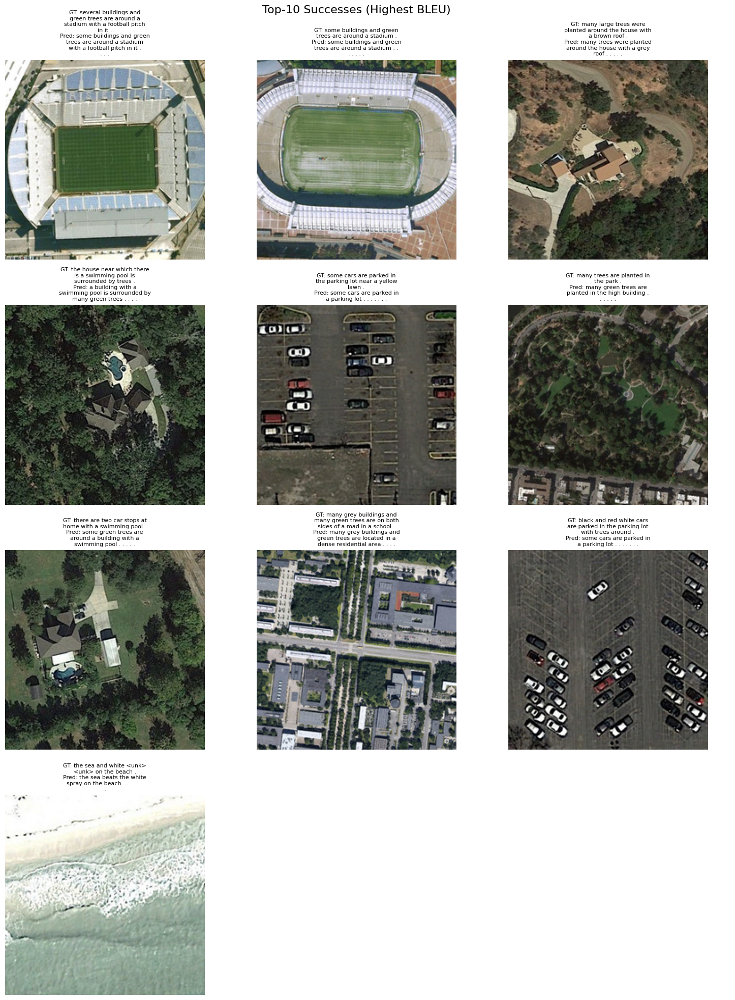

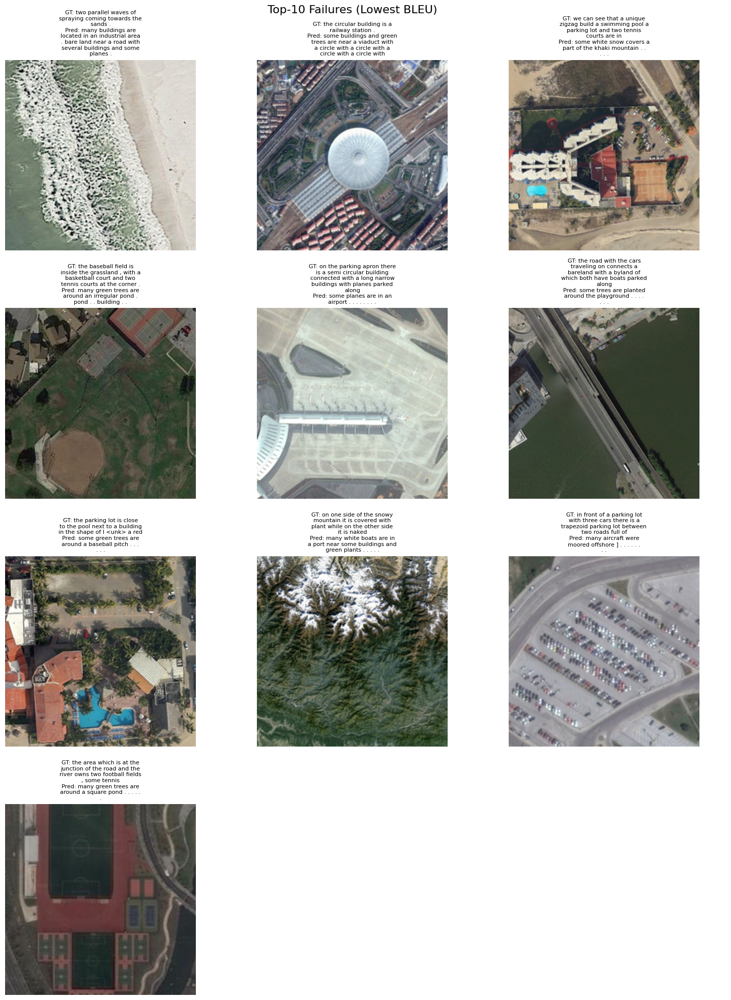

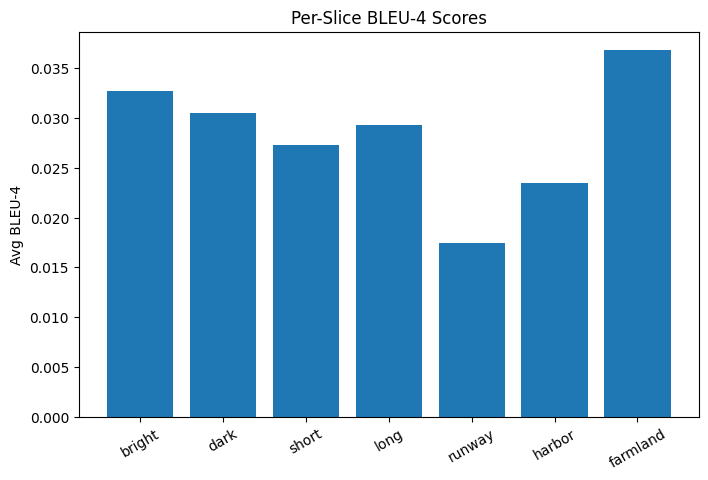

In [ ]:
#[1]
import io, ast, textwrap
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import torch

smooth_fn = SmoothingFunction().method4

# --- Helper: decode raw image using dataset + index ---
def load_raw_image(dataset, idx):
    """
    dataset: DataFrame with an 'image' column storing dicts/strings containing 'bytes'
    idx: integer index from dataset
    """
    byte_info = dataset.iloc[idx]['image']
    if isinstance(byte_info, str):
        img_dict = ast.literal_eval(byte_info)
    else:
        img_dict = byte_info
    image_bytes = img_dict['bytes']
    image = Image.open(io.BytesIO(image_bytes)).convert("RGB")
    return image

# --- Greedy decode for Transformer ---
def greedy_decode(model, img_features, max_len=30, bos_idx=1, eos_idx=2):
    """
    Greedy decoding for Transformer captioning model
    """
    B = img_features.size(0)
    device = img_features.device

    input_tokens = torch.full((B, 1), bos_idx, device=device, dtype=torch.long)  # start with <BOS>
    pred_tokens = []

    for _ in range(max_len):
        # Forward pass with correct order
        logits = model(input_tokens, img_features)  # [B, seq_len, vocab]
        next_token = logits[:, -1, :].argmax(dim=-1, keepdim=True)  # greedy step

        input_tokens = torch.cat([input_tokens, next_token], dim=1)
        pred_tokens.append(next_token)

        if (next_token.squeeze(1) == eos_idx).all():
            break

    return torch.cat(pred_tokens, dim=1)  # [B, T]


# --- 1. Collect predictions & metrics ---
all_examples = []

for (captions, img_features), (_, _, indices) in zip(test_loader_with_features_resnet, test_loader_for_features):
    captions = captions.to(device)
    img_features = img_features.to(device)
    B = captions.size(0)

    # Greedy decode with Transformer model
    pred_tokens = greedy_decode(model, img_features, max_len=captions.size(1))

    captions_np = captions.cpu().numpy()
    pred_tokens = pred_tokens.cpu().numpy()

    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]
        bleu = sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn)

        all_examples.append({
            "index": indices[i].item(),
            "gt": " ".join(gt_tokens),
            "pred": " ".join(pred_tokens_i),
            "bleu": bleu,
            "len_gt": len(gt_tokens)
        })

# --- 2. Pick 10 successes and 10 failures ---
all_examples.sort(key=lambda x: x["bleu"], reverse=True)
successes = all_examples[:10]
failures = all_examples[-10:]

def show_examples(examples, title, dataset, cols=3):
    rows = (len(examples) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    axes = axes.flatten()
    fig.suptitle(title, fontsize=16)
    
    for ax, ex in zip(axes, examples):
        raw_img = load_raw_image(dataset, ex["index"])
        ax.imshow(raw_img)
        ax.axis("off")
        
        # Wrap long text
        gt_wrapped = "\n".join(textwrap.wrap(f"GT: {ex['gt']}", width=30))
        pred_wrapped = "\n".join(textwrap.wrap(f"Pred: {ex['pred']}", width=30))
        ax.set_title(f"{gt_wrapped}\n{pred_wrapped}", fontsize=8)
    
    for ax in axes[len(examples):]:
        ax.axis("off")
    
    plt.tight_layout()
    plt.show()

show_examples(successes, "Top-10 Successes (Highest BLEU)", test_df)
show_examples(failures, "Top-10 Failures (Lowest BLEU)", test_df)

# --- 3. Slice Analysis ---
slice_bleus = {"bright": [], "dark": [], "short": [], "long": [], 
               "runway": [], "harbor": [], "farmland": []}

for ex in all_examples:
    raw_img = load_raw_image(test_df, ex["index"])
    mean_brightness = np.array(raw_img).mean() / 255.0
    if mean_brightness > 0.6:
        slice_bleus["bright"].append(ex["bleu"])
    else:
        slice_bleus["dark"].append(ex["bleu"])
    if ex["len_gt"] <= 8:
        slice_bleus["short"].append(ex["bleu"])
    elif ex["len_gt"] >= 16:
        slice_bleus["long"].append(ex["bleu"])
    if "runway" in ex["gt"]:
        slice_bleus["runway"].append(ex["bleu"])
    if "harbor" in ex["gt"]:
        slice_bleus["harbor"].append(ex["bleu"])
    if "farmland" in ex["gt"]:
        slice_bleus["farmland"].append(ex["bleu"])

slice_avg_bleus = {k: (np.mean(v) if len(v)>0 else 0) for k,v in slice_bleus.items()}

plt.figure(figsize=(8,5))
plt.bar(slice_avg_bleus.keys(), slice_avg_bleus.values())
plt.ylabel("Avg BLEU-4")
plt.title("Per-Slice BLEU-4 Scores")
plt.xticks(rotation=30)
plt.show()

### Training using MobileNet features

In [ ]:
#[1]
from tqdm import tqdm

# --- 1. Setup ---
VOCAB_SIZE = 2832
D_MODEL = 512
IMG_FEATURE_DIM = 1280
NHEAD = 8
NUM_LAYERS = 3
PAD_IDX = 0
NUM_EPOCHS = 20
LEARNING_RATE = 2e-4

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Instantiate the model
model = TransformerDecoder(
    vocab_size=VOCAB_SIZE,
    d_model=D_MODEL,
    nhead=NHEAD,
    num_layers=NUM_LAYERS,
    img_feature_dim=IMG_FEATURE_DIM,
    pad_idx=PAD_IDX
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=PAD_IDX)
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

# --- 2. Training Loop ---
for epoch in range(NUM_EPOCHS):
    model.train()
    epoch_loss = 0.0
    progress_bar = tqdm(train_loader_with_features_mobilenet, desc=f"Epoch {epoch+1}/{NUM_EPOCHS}")

    for captions, img_features in progress_bar:
        captions = captions.to(device)       # [B, seq_len]
        img_features = img_features.to(device)  # [B, 512]

        # Input: all tokens except last
        input_captions = captions[:, :-1]    # [B, seq_len-1]
        # Target: all tokens except first (<BOS>)
        target_captions = captions[:, 1:]    # [B, seq_len-1]

        optimizer.zero_grad()
        outputs = model(input_captions, img_features)  # [B, seq_len-1, vocab_size]

        # CrossEntropyLoss expects [N, C] and [N]
        loss = criterion(outputs.reshape(-1, VOCAB_SIZE), target_captions.reshape(-1))
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        progress_bar.set_postfix(loss=loss.item())

    avg_epoch_loss = epoch_loss / len(train_loader_with_features_mobilenet)
    print(f"End of Epoch {epoch+1}, Average Loss: {avg_epoch_loss:.4f}")

print("Training finished!")

Using device: cuda


Epoch 1/20: 100%|██████████| 273/273 [00:09<00:00, 28.24it/s, loss=2.46]


End of Epoch 1, Average Loss: 2.6483


Epoch 2/20: 100%|██████████| 273/273 [00:09<00:00, 29.47it/s, loss=1.97]


End of Epoch 2, Average Loss: 1.8347


Epoch 3/20: 100%|██████████| 273/273 [00:09<00:00, 29.43it/s, loss=1.34]


End of Epoch 3, Average Loss: 1.5979


Epoch 4/20: 100%|██████████| 273/273 [00:09<00:00, 29.40it/s, loss=1.51] 


End of Epoch 4, Average Loss: 1.4370


Epoch 5/20: 100%|██████████| 273/273 [00:09<00:00, 29.38it/s, loss=1.21] 


End of Epoch 5, Average Loss: 1.3052


Epoch 6/20: 100%|██████████| 273/273 [00:09<00:00, 28.79it/s, loss=1.04] 


End of Epoch 6, Average Loss: 1.1918


Epoch 7/20: 100%|██████████| 273/273 [00:09<00:00, 28.79it/s, loss=1.18] 


End of Epoch 7, Average Loss: 1.0854


Epoch 8/20: 100%|██████████| 273/273 [00:09<00:00, 28.66it/s, loss=0.904]


End of Epoch 8, Average Loss: 0.9923


Epoch 9/20: 100%|██████████| 273/273 [00:09<00:00, 28.84it/s, loss=0.975]


End of Epoch 9, Average Loss: 0.9061


Epoch 10/20: 100%|██████████| 273/273 [00:09<00:00, 28.53it/s, loss=0.893]


End of Epoch 10, Average Loss: 0.8273


Epoch 11/20: 100%|██████████| 273/273 [00:09<00:00, 28.58it/s, loss=0.685]


End of Epoch 11, Average Loss: 0.7574


Epoch 12/20: 100%|██████████| 273/273 [00:09<00:00, 28.76it/s, loss=0.736]


End of Epoch 12, Average Loss: 0.6955


Epoch 13/20: 100%|██████████| 273/273 [00:09<00:00, 28.86it/s, loss=0.765]


End of Epoch 13, Average Loss: 0.6441


Epoch 14/20: 100%|██████████| 273/273 [00:09<00:00, 29.14it/s, loss=0.639]


End of Epoch 14, Average Loss: 0.5967


Epoch 15/20: 100%|██████████| 273/273 [00:09<00:00, 28.84it/s, loss=0.531]


End of Epoch 15, Average Loss: 0.5570


Epoch 16/20: 100%|██████████| 273/273 [00:09<00:00, 29.17it/s, loss=0.559]


End of Epoch 16, Average Loss: 0.5214


Epoch 17/20: 100%|██████████| 273/273 [00:09<00:00, 29.19it/s, loss=0.515]


End of Epoch 17, Average Loss: 0.4866


Epoch 18/20: 100%|██████████| 273/273 [00:09<00:00, 29.59it/s, loss=0.477]


End of Epoch 18, Average Loss: 0.4584


Epoch 19/20: 100%|██████████| 273/273 [00:09<00:00, 29.51it/s, loss=0.449]


End of Epoch 19, Average Loss: 0.4298


Epoch 20/20: 100%|██████████| 273/273 [00:09<00:00, 29.65it/s, loss=0.471]

End of Epoch 20, Average Loss: 0.4074
Training finished!


### Metrics for MobileNet + Transformer

In [ ]:
#[1]
smooth_fn = SmoothingFunction().method1

all_pred_tokens = []  # predicted token IDs from model
all_gt_tokens = []    # ground truth token IDs

# --- 1. Generate predictions for the validation set ---
model.eval()
for captions, img_features in valid_loader_with_features_mobilenet:  # [B, seq_len], [B, 512]
    captions = captions.to(device)
    img_features = img_features.to(device)
    B, seq_len = captions.size()

    # Greedy decoding
    input_token = torch.full((B, 1), 1, device=device, dtype=torch.long)
    pred_tokens = []

    for t in range(max_len):
        tok_emb = model.embedding(input_token) + model.pos_embedding[:, :input_token.size(1), :]
        mem = model.img_proj(img_features).view(B, model.mem_tokens, model.d_model)
        mem = model.mem_norm(mem)

        output = model.transformer_decoder(tgt=tok_emb, memory=mem)
        logits = model.classifier(output[:, -1, :])
        next_token = logits.argmax(dim=-1, keepdim=True)
        pred_tokens.append(next_token)
        input_token = torch.cat([input_token, next_token], dim=1)

        if (next_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1)  # [B, seq_len_generated]
    all_pred_tokens.extend(pred_tokens.cpu().tolist())
    all_gt_tokens.extend(captions.cpu().tolist())

# --- 2. Compute metrics ---
bleu_scores = []
meteor_scores = []
lengths = []
degenerate_count = 0
total_tokens = 0

for gt, pred in zip(all_gt_tokens, all_pred_tokens):
    # Convert IDs to words, ignore special tokens
    gt_tokens = [idx_to_word_dict[t] for t in gt if t not in [1, 2, 0]]
    pred_tokens_i = [idx_to_word_dict[t] for t in pred if t not in [1, 2, 0]]

    # BLEU-4
    bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

    # METEOR
    meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

    # Caption length
    lengths.append(len(pred_tokens_i))

    # Degenerate repetitions (≥3 identical tokens)
    for i in range(len(pred_tokens_i)-2):
        if pred_tokens_i[i] == pred_tokens_i[i+1] == pred_tokens_i[i+2]:
            degenerate_count += 1
    total_tokens += len(pred_tokens_i)

# --- 3. Report metrics ---
print(f"Validation Metrics (Transformer + ResNet18):")
print(f"BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: {np.mean(lengths):.2f} ± {np.std(lengths):.2f}")
print(f"Degenerate repetitions ≥3: {degenerate_count} ({degenerate_count/total_tokens*100:.2f}%)")

Validation Metrics (Transformer + ResNet18):
BLEU-4: 0.0540
METEOR: 0.2529
Caption length: 17.92 ± 1.41
Degenerate repetitions ≥3: 1484 (7.57%)


In [ ]:
#[1]
smooth_fn = SmoothingFunction().method1

all_pred_tokens = []  # predicted token IDs from model
all_gt_tokens = []    # ground truth token IDs

# --- 1. Generate predictions for the validation set ---
model.eval()
for captions, img_features in test_loader_with_features_mobilenet:  # [B, seq_len], [B, 512]
    captions = captions.to(device)
    img_features = img_features.to(device)
    B, seq_len = captions.size()

    # Greedy decoding
    input_token = torch.full((B, 1), 1, device=device, dtype=torch.long)
    pred_tokens = []

    for t in range(max_len):
        tok_emb = model.embedding(input_token) + model.pos_embedding[:, :input_token.size(1), :]
        mem = model.img_proj(img_features).view(B, model.mem_tokens, model.d_model)
        mem = model.mem_norm(mem)

        output = model.transformer_decoder(tgt=tok_emb, memory=mem)
        logits = model.classifier(output[:, -1, :])
        next_token = logits.argmax(dim=-1, keepdim=True)
        pred_tokens.append(next_token)
        input_token = torch.cat([input_token, next_token], dim=1)

        if (next_token.squeeze(1) == 2).all():
            break

    pred_tokens = torch.cat(pred_tokens, dim=1)  # [B, seq_len_generated]
    all_pred_tokens.extend(pred_tokens.cpu().tolist())
    all_gt_tokens.extend(captions.cpu().tolist())

# --- 2. Compute metrics ---
bleu_scores = []
meteor_scores = []
lengths = []
degenerate_count = 0
total_tokens = 0

for gt, pred in zip(all_gt_tokens, all_pred_tokens):
    # Convert IDs to words, ignore special tokens
    gt_tokens = [idx_to_word_dict[t] for t in gt if t not in [1, 2, 0]]
    pred_tokens_i = [idx_to_word_dict[t] for t in pred if t not in [1, 2, 0]]

    # BLEU-4
    bleu_scores.append(sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn))

    # METEOR
    meteor_scores.append(meteor_score([gt_tokens], pred_tokens_i))

    # Caption length
    lengths.append(len(pred_tokens_i))

    # Degenerate repetitions (≥3 identical tokens)
    for i in range(len(pred_tokens_i)-2):
        if pred_tokens_i[i] == pred_tokens_i[i+1] == pred_tokens_i[i+2]:
            degenerate_count += 1
    total_tokens += len(pred_tokens_i)

# --- 3. Report metrics ---
print(f"Testing Metrics (Transformer + ResNet18):")
print(f"BLEU-4: {np.mean(bleu_scores):.4f}")
print(f"METEOR: {np.mean(meteor_scores):.4f}")
print(f"Caption length: {np.mean(lengths):.2f} ± {np.std(lengths):.2f}")
print(f"Degenerate repetitions ≥3: {degenerate_count} ({degenerate_count/total_tokens*100:.2f}%)")

Testing Metrics (Transformer + ResNet18):
BLEU-4: 0.0238
METEOR: 0.1730
Caption length: 17.99 ± 1.36
Degenerate repetitions ≥3: 1495 (7.60%)


| Metric                        | Validation (MobileNet+Transformer) | Testing (MobileNet+Transformer) |
|-------------------------------|------------------------|------------------------------|
| Avg BLEU-4                    | 0.0540              | 0.0238                       |
| Avg METEOR                    | 0.2529                  | 0.1730                       |
| Caption length (mean ± std)   | 17.92 ± 1.41            | 17.99 ± 1.36                 |
| % captions with degeneracy    | 7.57%                | 7.60%                       |

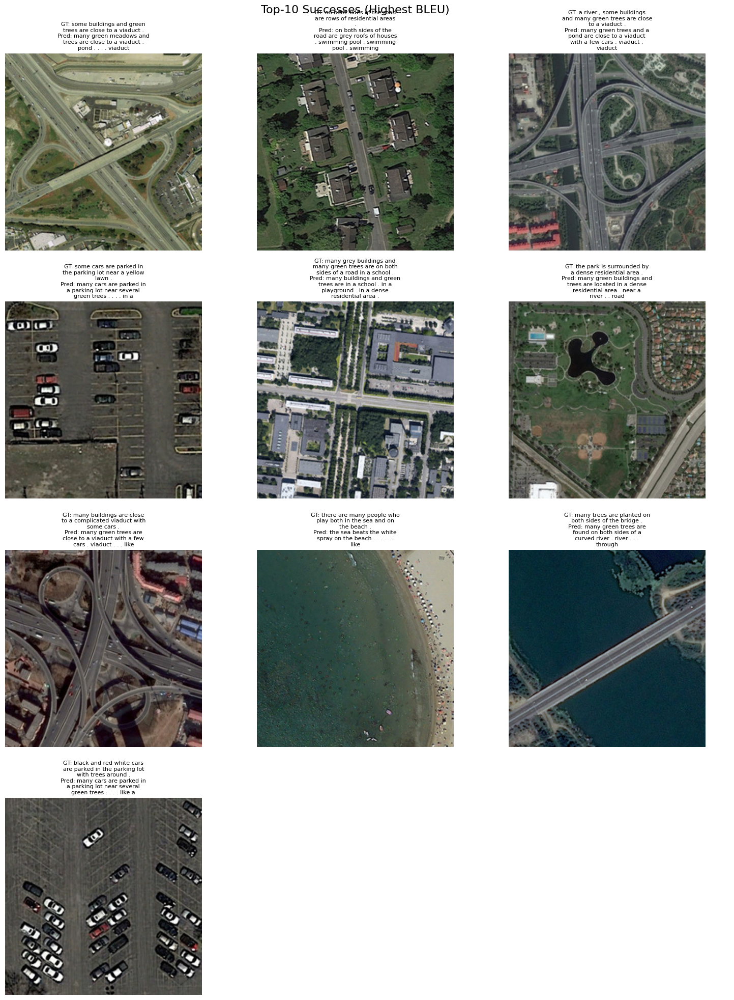

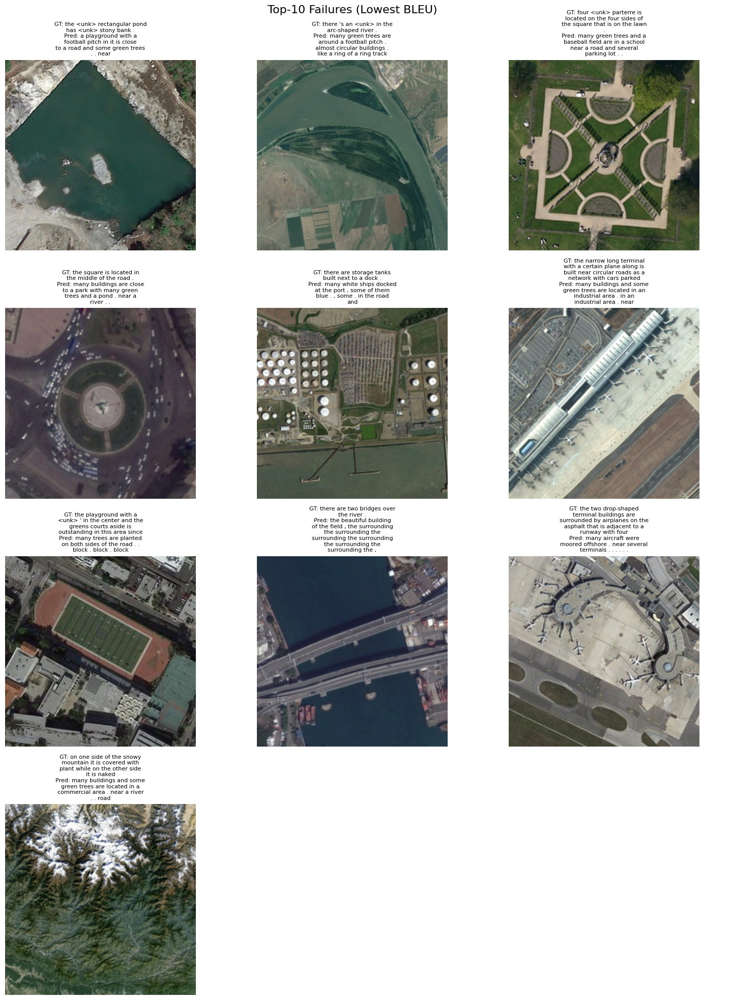

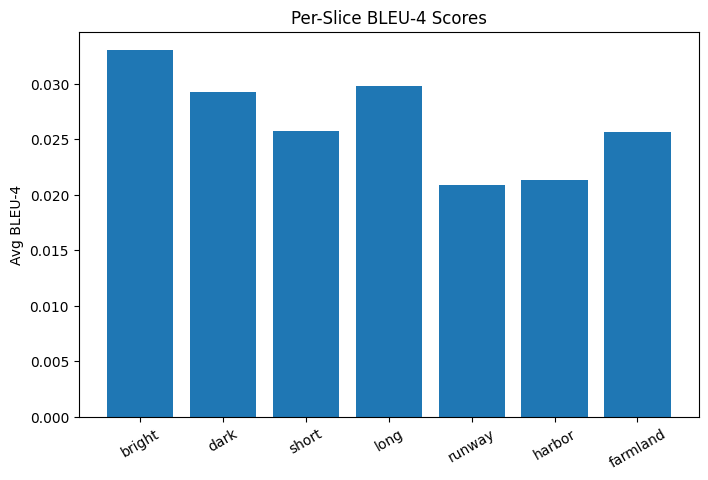

In [ ]:
#[1]
smooth_fn = SmoothingFunction().method4

# --- Helper: decode raw image using dataset + index ---
def load_raw_image(dataset, idx):
    """
    dataset: DataFrame with an 'image' column storing dicts/strings containing 'bytes'
    idx: integer index from dataset
    """
    byte_info = dataset.iloc[idx]['image']
    if isinstance(byte_info, str):
        img_dict = ast.literal_eval(byte_info)
    else:
        img_dict = byte_info
    image_bytes = img_dict['bytes']
    image = Image.open(io.BytesIO(image_bytes)).convert("RGB")
    return image

# --- Greedy decode for Transformer ---
def greedy_decode(model, img_features, max_len=30, bos_idx=1, eos_idx=2):
    """
    Greedy decoding for Transformer captioning model
    """
    B = img_features.size(0)
    device = img_features.device

    input_tokens = torch.full((B, 1), bos_idx, device=device, dtype=torch.long)  # start with <BOS>
    pred_tokens = []

    for _ in range(max_len):
        # Forward pass with correct order
        logits = model(input_tokens, img_features)  # [B, seq_len, vocab]
        next_token = logits[:, -1, :].argmax(dim=-1, keepdim=True)  # greedy step

        input_tokens = torch.cat([input_tokens, next_token], dim=1)
        pred_tokens.append(next_token)

        if (next_token.squeeze(1) == eos_idx).all():
            break

    return torch.cat(pred_tokens, dim=1)  # [B, T]


# --- 1. Collect predictions & metrics ---
all_examples = []

for (captions, img_features), (_, _, indices) in zip(test_loader_with_features_mobilenet, test_loader_for_features):
    captions = captions.to(device)
    img_features = img_features.to(device)
    B = captions.size(0)

    # Greedy decode with Transformer model
    pred_tokens = greedy_decode(model, img_features, max_len=captions.size(1))

    captions_np = captions.cpu().numpy()
    pred_tokens = pred_tokens.cpu().numpy()

    for i in range(B):
        gt_tokens = [idx_to_word_dict[t] for t in captions_np[i] if t not in [0,1,2]]
        pred_tokens_i = [idx_to_word_dict[t] for t in pred_tokens[i] if t not in [0,1,2]]
        bleu = sentence_bleu([gt_tokens], pred_tokens_i, smoothing_function=smooth_fn)

        all_examples.append({
            "index": indices[i].item(),
            "gt": " ".join(gt_tokens),
            "pred": " ".join(pred_tokens_i),
            "bleu": bleu,
            "len_gt": len(gt_tokens)
        })

# --- 2. Pick 10 successes and 10 failures ---
all_examples.sort(key=lambda x: x["bleu"], reverse=True)
successes = all_examples[:10]
failures = all_examples[-10:]

def show_examples(examples, title, dataset, cols=3):
    rows = (len(examples) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    axes = axes.flatten()
    fig.suptitle(title, fontsize=16)
    
    for ax, ex in zip(axes, examples):
        raw_img = load_raw_image(dataset, ex["index"])
        ax.imshow(raw_img)
        ax.axis("off")
        
        # Wrap long text
        gt_wrapped = "\n".join(textwrap.wrap(f"GT: {ex['gt']}", width=30))
        pred_wrapped = "\n".join(textwrap.wrap(f"Pred: {ex['pred']}", width=30))
        ax.set_title(f"{gt_wrapped}\n{pred_wrapped}", fontsize=8)
    
    for ax in axes[len(examples):]:
        ax.axis("off")
    
    plt.tight_layout()
    plt.show()

show_examples(successes, "Top-10 Successes (Highest BLEU)", test_df)
show_examples(failures, "Top-10 Failures (Lowest BLEU)", test_df)

# --- 3. Slice Analysis ---
slice_bleus = {"bright": [], "dark": [], "short": [], "long": [], 
               "runway": [], "harbor": [], "farmland": []}

for ex in all_examples:
    raw_img = load_raw_image(test_df, ex["index"])
    mean_brightness = np.array(raw_img).mean() / 255.0
    if mean_brightness > 0.6:
        slice_bleus["bright"].append(ex["bleu"])
    else:
        slice_bleus["dark"].append(ex["bleu"])
    if ex["len_gt"] <= 8:
        slice_bleus["short"].append(ex["bleu"])
    elif ex["len_gt"] >= 16:
        slice_bleus["long"].append(ex["bleu"])
    if "runway" in ex["gt"]:
        slice_bleus["runway"].append(ex["bleu"])
    if "harbor" in ex["gt"]:
        slice_bleus["harbor"].append(ex["bleu"])
    if "farmland" in ex["gt"]:
        slice_bleus["farmland"].append(ex["bleu"])

slice_avg_bleus = {k: (np.mean(v) if len(v)>0 else 0) for k,v in slice_bleus.items()}

plt.figure(figsize=(8,5))
plt.bar(slice_avg_bleus.keys(), slice_avg_bleus.values())
plt.ylabel("Avg BLEU-4")
plt.title("Per-Slice BLEU-4 Scores")
plt.xticks(rotation=30)
plt.show()

### NOTE:
Cells starting with #[1] were generated using ChatGPT 